## Import amazing libraries

In [ ]:
!pip install ray
!pip install captum

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 19.9 MB/s eta 0:00:00a 0:00:01


In [ ]:
from __future__ import print_function, division
import os
import random
import torch
import pandas as pd
from skimage import io, transform
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils
import datetime
import collections


# pytorch
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim import lr_scheduler
from torch.autograd import Variable
from torch.utils.data.sampler import WeightedRandomSampler
from torchvision.io import read_image
from torch.utils.data import Dataset,DataLoader,ConcatDataset
from torchvision.io.image import ImageReadMode
from torchvision.transforms import ToTensor, Lambda
from torchvision import datasets, transforms, models

# Ray Tune
from ray import tune
from ray.tune import CLIReporter
from ray.tune.schedulers import ASHAScheduler
from functools import partial

#Captum
from captum.attr import IntegratedGradients
from captum.attr import LayerConductance
from captum.attr import NeuronConductance

# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

plt.ion()   # interactive mode

use_cuda = True
dtype = torch.float
device = torch.device("cuda" if (use_cuda and torch.cuda.is_available()) else "cpu")
print(device)

cuda


In [ ]:
def seed_torch(seed=2145):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed) # if you are using multi-GPU.
    torch.backends.cudnn.benchmark = False
    #torch.use_deterministic_algorithms()
    torch.backends.cudnn.deterministic = True

seed_torch()

Before we begin, it's important to examine our data labels and identify any issues that may exist. As we review the data, we can observe that there is an **imbalance** in the distribution of classes, with class 0 and 2 being underrepresented. However, we can address this imbalance by creating a **custom data loader** that incorporates **data augmentation techniques to generate additional samples** for the underrepresented classes.

<AxesSubplot:>

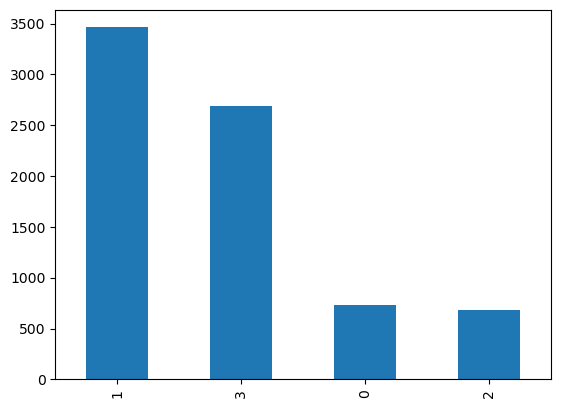

In [ ]:
train_data=pd.read_csv('/kaggle/input/deep-learning-for-msc-2022-23/train.csv')
train_data['Label'].value_counts().plot(kind='bar')

In [ ]:
train_data.groupby('Label').size()

Label
0     729
1    3462
2     679
3    2690
dtype: int64

<AxesSubplot:ylabel=' Nucleus Data'>

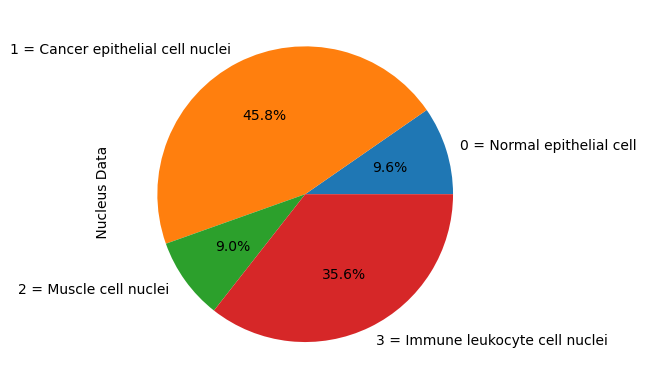

In [ ]:
train_data.groupby('Label').size().plot(kind='pie',
                                       y = "Label",
                                       label = " Nucleus Data",
                                       labels=['0 = Normal epithelial cell','1 = Cancer epithelial cell nuclei','2 = Muscle cell nuclei ','3 = Immune leukocyte cell nuclei'],
                                       autopct='%1.1f%%')

Before we jump into solving the imbalance issue using custom data loader, we will look into our data images and labels

Cell Type : Normal epithelial cell  [ 0 ]


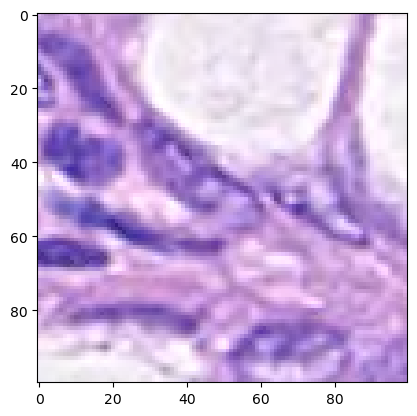

In [ ]:
def show_Image_with_Label(image, label):
    """Show image with cell label"""

    # convert label to text
    if label == 0:
        print('Cell Type : Normal epithelial cell  [',label,']')
    if label == 1:
        print('Cell Type : Cancer epithelial cell nuclei   [',label,']')
    if label == 2:
        print('Cell Type : Muscle cell nuclei [',label,']')
    if label == 3:
        print('Cell Type : Immune leukocyte cell nuclei [',label,']')

    plt.imshow(image)
    plt.pause(0.001)  # pause a bit so that plots are updated


# example of an image with its cell type
plt.figure()
show_Image_with_Label(io.imread(os.path.join('/kaggle/input/deep-learning-for-msc-2022-23/train', '1'+'.png')),
               train_data.iloc[0,1])
plt.show()

## Custom Data loader for nucleus images and csv data

In [ ]:
class NucleusDataset(Dataset):
    """Nucleus dataset."""

    def __init__(self, csv_file, root_dir, transform=None):
        """
        Args:
            csv_file (string): Path to the csv file with annotations.
            root_dir (string): Directory with all the images.
            transform (callable, optional): Optional transform to be applied
                on a sample.
        """
        self.nucleus_dataframe = pd.read_csv(csv_file)
        self.root_dir = root_dir
        self.transform = transform

    def __len__(self):
        return len(self.nucleus_dataframe)

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()
        img_name = os.path.join(self.root_dir,
                                self.nucleus_dataframe.iloc[idx, 0])
        image = io.imread(img_name)
        label = self.nucleus_dataframe.iloc[idx, 1]
        sample = {'image': image, 'label': label}

        if self.transform:
            sample['image'] = self.transform(sample['image'])

        return sample

In [ ]:
class AgumentedNucleusDataset(Dataset):
    """Agumented Nucleus dataset."""

    def __init__(self, csv_file, root_dir, transform=None,augment_freq=1):
        """
        Args:
            csv_file (string): Path to the csv file with annotations.
            root_dir (string): Directory with all the images.
            transform (callable, optional): Optional transform to be applied
                on a sample.
            augment frequency : default is 1 and can be set to augment frequency of images
        """
        self.nucleus_dataframe = csv_file
        self.root_dir = root_dir
        self.transform = transform
        self.augment_freq = augment_freq


    def __len__(self):
        return len(self.nucleus_dataframe)*self.augment_freq

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()
        idx = idx%len(self.nucleus_dataframe)
        img_name = os.path.join(self.root_dir,
                                self.nucleus_dataframe.iloc[idx, 0])
        image = io.imread(img_name)
        label = self.nucleus_dataframe.iloc[idx, 1]
        sample = {'image': image, 'label': label}

        if self.transform:
            sample['image'] = self.transform(sample['image'])

        return sample

Lets read the nucleus dataset and visualize some of its data

0 image shape:  (100, 100, 3) -- label :  0
Cell Type : Normal epithelial cell  [ 0 ]


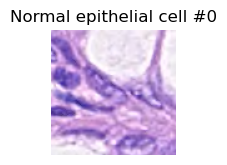

1 image shape:  (100, 100, 3) -- label :  0
Cell Type : Normal epithelial cell  [ 0 ]


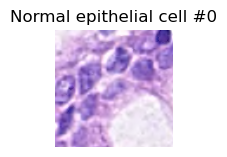

2 image shape:  (100, 100, 3) -- label :  0
Cell Type : Normal epithelial cell  [ 0 ]


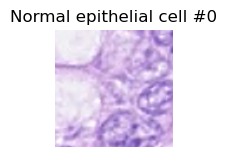

3 image shape:  (100, 100, 3) -- label :  0
Cell Type : Normal epithelial cell  [ 0 ]


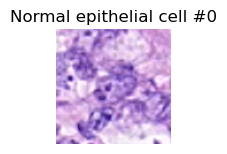

In [ ]:
nucleus_dataset = NucleusDataset(csv_file='/kaggle/input/deep-learning-for-msc-2022-23/train.csv',
                                    root_dir='/kaggle/input/deep-learning-for-msc-2022-23/train')

fig = plt.figure()

for i in range(len(nucleus_dataset)):
    sample = nucleus_dataset[i]

    print(i, 'image shape: ',sample['image'].shape,'--', 'label : ',sample['label'])

    ax = plt.subplot(1, 4, i + 1)
    plt.tight_layout()

    # convert label to text
    if sample['label'] == 0:
        ax.set_title('Normal epithelial cell #{}'.format(sample['label']))
    if sample['label'] == 1:
        ax.set_title('Cancer epithelial cell nuclei #{}'.format(sample['label']))
    if sample['label'] == 2:
        ax.set_title('Muscle cell nuclei #{}'.format(sample['label']))
    if sample['label'] == 3:
        ax.set_title('Immune leukocyte cell nuclei #{}'.format(sample['label']))
    ax.axis('off')
    show_Image_with_Label(**sample)

    if i == 3:
        plt.show()
        break

We can also do below, showing a simple example of cancer data

Cell Type : Cancer epithelial cell nuclei   [ 1 ]


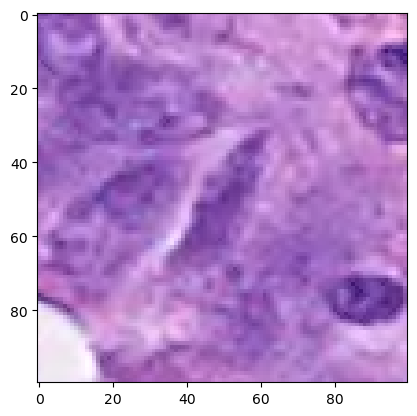

In [ ]:
show_Image_with_Label(**(nucleus_dataset.__getitem__(1000)))

We can use ```transforms``` method in pytorch to augment our images while loading them in dataloader. I am using vertical and horizontal flip with random rotation to add variation in the data so that our model dont get overfit easily and learn features which make model more robust and rotational invariant.

We will apply normalization in our tranforms, below code computes mean and standard deviation for all images

In [ ]:
# images_rgb =[image['image']/255 for image in nucleus_dataset]
# # Each image_rgb is of shape (n, 3),
# # where n is the number of pixels in each image,
# # and 3 are the channels: R, G, B.

# means = []
# for image_rgb in images_rgb:
#     means.append(np.mean(image_rgb, axis=0))
# mu_rgb = np.mean(means, axis=0)  # mu_rgb.shape == (3,)
# mean = np.mean(mu_rgb,axis=0)

# variances = []
# for image_rgb in images_rgb:
#     var = np.mean((image_rgb - mu_rgb) ** 2, axis=0)
#     variances.append(var)
# std_rgb = np.sqrt(np.mean(variances, axis=0))  # std_rgb.shape == (3,)
# std = np.mean(std_rgb,axis=0)

# print(mean)
# print(std)


In [ ]:
#Calculated from above. Because of memory problems values has been extracted and used statically
mean=[0.75943721,0.61563219,0.82119109]
std=[0.17291876,0.19785331,0.11776269]

transform_augmentation = transforms.Compose([
        transforms.ToPILImage(),
        transforms.ToTensor(),
        transforms.RandomVerticalFlip(),
        transforms.RandomHorizontalFlip(),
        transforms.RandomRotation((10,90)),
        transforms.Normalize(mean, std),

    ])

transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.ToTensor(),
    transforms.Normalize(mean, std),

])

### Create augmented dataset using transform for class 0 & 2


In [ ]:
#nucleus_dataset
normal_type_data = train_data[train_data['Label']==0]
muscle_type_data = train_data[train_data['Label']==2]


nucleus_dataset_transformed = NucleusDataset(csv_file='/kaggle/input/deep-learning-for-msc-2022-23/train.csv',
                                    root_dir='/kaggle/input/deep-learning-for-msc-2022-23/train',
                                    transform=transform)

normal_type_augmented_nucleus_dataset = AgumentedNucleusDataset(
    csv_file=normal_type_data,
    root_dir='/kaggle/input/deep-learning-for-msc-2022-23/train',
    transform=transform_augmentation,
    augment_freq=4
)

mucle_type_augmented_nucleus_dataset = AgumentedNucleusDataset(
    csv_file=muscle_type_data,
    root_dir='/kaggle/input/deep-learning-for-msc-2022-23/train',
    transform=transform_augmentation,
    augment_freq=4
)

nucleus_dataset_balanced = torch.utils.data.ConcatDataset([
    nucleus_dataset_transformed,
    normal_type_augmented_nucleus_dataset,
    mucle_type_augmented_nucleus_dataset
])

print('Imbalanced data set',len(nucleus_dataset_transformed))
print('After augmentation of class 0  & 2 : ')
print(" - Augmented dataset size: ", len(nucleus_dataset_balanced))

Imbalanced data set 7560
After augmentation of class 0  & 2 : 
 - Augmented dataset size:  13192


An example below for an image, and below it is the same image  after applying the transfomration function on mutiple copies

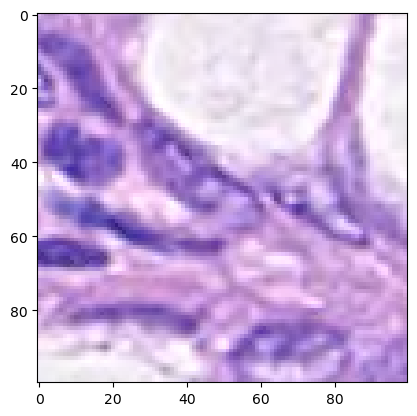

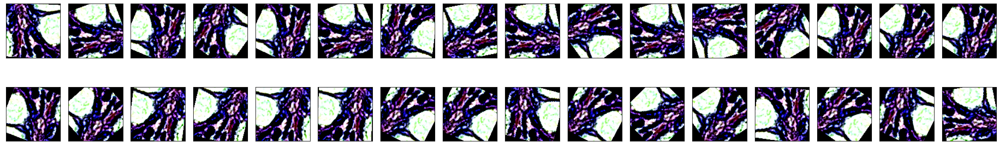

In [ ]:
BATCH_SIZE=32

#take a sample image
nuc=nucleus_dataset[0]['image']

#show that original image
plt.imshow(nuc)

fig = plt.figure(figsize = (25,5))

for i in range(BATCH_SIZE):
    ax = fig.add_subplot(2 , int(BATCH_SIZE/2) , i+1, xticks = [] , yticks = [])

    #apply transformation
    test1=transform_augmentation(nuc)
    test1=test1.permute(1, 2, 0)
    ax.imshow(test1)

plt.tight_layout()

# Split The data into 70% training set and 30% validation set

In [ ]:
length_set = [int(len(nucleus_dataset_balanced)*0.7), int(len(nucleus_dataset_balanced)*0.3)+1]# + 1 for the last element cause index start from 0
length_set

[9234, 3958]

In [ ]:
BATCH_SIZE=32

train_set, val_set = torch.utils.data.random_split(nucleus_dataset_balanced, length_set)


train_nucleus_dataloader = DataLoader(train_set, batch_size=BATCH_SIZE,
                                     shuffle=True, num_workers=0)

val_nucleus_dataloader = DataLoader(val_set, batch_size=BATCH_SIZE,
                                     shuffle=False, num_workers=0)

full_neucleus_dataloader = DataLoader(nucleus_dataset_balanced, batch_size=BATCH_SIZE,
                              shuffle=True, num_workers=0)

print('train_set size 70% :', length_set[0], ' \nvalidation_set size 30% :', length_set[1])

train_set size 70% : 9234  
validation_set size 30% : 3958


In [ ]:
# helper method to show batch images
def show_batch_images(images,labels,batch_size):
    fig = plt.figure(figsize = (25,5))
    for i in range(batch_size):
        ax = fig.add_subplot(2 , int(batch_size/2) , i+1, xticks = [] , yticks = [])
        ax.imshow(images[i].transpose(2,1,0).squeeze())
        temp_label=labels[i]
        if temp_label == 0:
            ax.set_title('Normal#{}'.format(temp_label))
        if temp_label == 1:
            ax.set_title('Cancer#{}'.format(temp_label))
        if temp_label == 2:
            ax.set_title('Muscle#{}'.format(temp_label))
        if temp_label == 3:
            ax.set_title('Immune#{}'.format(temp_label))
    plt.tight_layout()

# Visualize a batch of Train Data

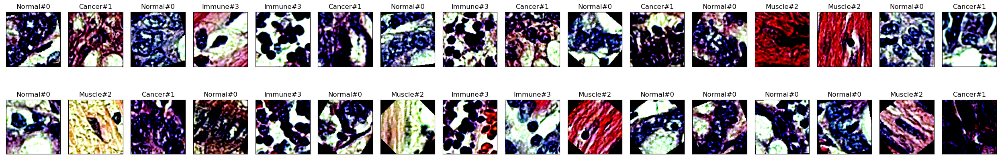

In [ ]:
iterator = next(iter(train_nucleus_dataloader))
images , labels =  np.asarray(iterator['image']) ,  np.asarray(iterator['label'])
show_batch_images(images,labels,BATCH_SIZE)

# Visualize a batch of Validation Data

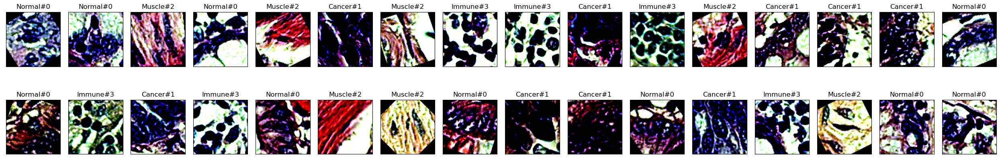

In [ ]:
iterator = next(iter(val_nucleus_dataloader))
images , labels =  np.asarray(iterator['image']) ,  np.asarray(iterator['label'])
show_batch_images(images,labels,BATCH_SIZE)

#### Now since all set! lets build our Models

# Convolutional Neural Networks


![https://towardsdatascience.com/a-comprehensive-guide-to-convolutional-neural-networks-the-eli5-way-3bd2b1164a53](https://miro.medium.com/v2/resize:fit:720/format:webp/1*uAeANQIOQPqWZnnuH-VEyw.jpeg)

# Task 1: Building a small ConvNet with no more than 8 layers total

I have experimented with several CNN-based model architectures, referred to as ```model_cnn_x```. Among these models, the best performing architecture was ```model_cnn_1```, which includes three convolutional layers with pooling and one fully connected layer. To extract local features from the images, given our image size of only 100x100, I chose a filter size of three instead of high-level features.

In [ ]:
import collections

def model_cnn_1():
    return nn.Sequential(collections.OrderedDict([
              ('conv1', nn.Conv2d(3,128,3)), #128x98x98
              ('relu1', nn.ReLU()),
              ('maxpool1', nn.MaxPool2d(2,2)), #64x49x49
              ('conv2', nn.Conv2d(128,64,3)), #64x47x47
              ('relu2', nn.ReLU()),
              ('maxpool2', nn.MaxPool2d(2,2)), #64x23x23
              ('conv3', nn.Conv2d(64,32,3)), #32x21x21
              ('relu3', nn.ReLU()),
              ('maxpool3', nn.MaxPool2d(2,2)), #32x10x10
              ('flatten', nn.Flatten()),
              ('fc1', nn.Linear(32*10*10,4))
            ]))

def model_cnn_2():
    return nn.Sequential(collections.OrderedDict([
              ('conv1', nn.Conv2d(3,200,3,padding=1)), #200x100x100
              ('relu1', nn.ReLU()),
              ('conv2', nn.Conv2d(200,100,3,padding=1)), #100x100x100
              ('relu2', nn.ReLU()),
              ('conv3', nn.Conv2d(100,50,3,padding=1)), #50x100x100
              ('relu3', nn.ReLU()),
              ('maxpool1', nn.MaxPool2d(2)), #50x50x50
              ('flatten', nn.Flatten()),
              ('fc1', nn.Linear(50*50*50,1028)),
              ('relu3', nn.ReLU()),
              ('fc2', nn.Linear(1028,512)),
              ('relu4', nn.ReLU()),
              ('fc3', nn.Linear(512,256)),
              ('relu5', nn.ReLU()),
              ('fc4', nn.Linear(256,4))
            ]))

def model_cnn_3():
    return nn.Sequential(collections.OrderedDict([
              ('conv1', nn.Conv2d(3,100,3)), #100x98x98
              ('relu1', nn.ReLU()),
              ('maxpool1', nn.MaxPool2d(2,2)), #100x49x49
              ('conv2', nn.Conv2d(100,50,3)), #50x47x47
              ('relu2', nn.ReLU()),
              ('maxpool2', nn.MaxPool2d(2,2)), #50x23x23
              ('conv3', nn.Conv2d(50,25,3)), #25x21x21
              ('relu3', nn.ReLU()),
              ('maxpool3', nn.MaxPool2d(2,2)), #25x10x10
              ('flatten', nn.Flatten()),
              ('fc1', nn.Linear(25*10*10,4))
            ]))



1. ```training_loop``` function is designed to train a model for a specified number of epochs using the SGD optimizer.
2. ```validation_loop``` function calculates the average loss and accuracy of the model for a given dataset (train/validation).
3. ```train_validate_graph``` function is used to train and validate a specific CNN model, calculate the average loss and accuracy, and plot the results on a graph for a set number of epochs.
4. ```train_validate_graph_raytune``` method is used specifically to train the model with ray tune hyperparameter optimization.
5. ```test_accuracy_and_submit```  method takes a model, applies various transformations on test images using a voting mechanism, obtains the highest class vote, and generates a ```submission.csv``` file to be submitted on Kaggle.

In [ ]:
def training_loop(n_epochs,
                  model: torch.nn.Module,
                  device,
                  lr,
                  momentum,
                  weight_decay,
                  train_loader) -> nn.Module:

    #optimizer
    optimizer = optim.SGD(model.parameters(), lr=lr, weight_decay=weight_decay, momentum=momentum)

    #loss function
    loss_fn = nn.CrossEntropyLoss()

    # moving model to cuda
    model = model.to(device)

    for epoch in range(1, n_epochs + 1):
        loss_train = 0.0
        for data in train_loader:
            imgs = data['image']
            outputs = model(imgs.to(device))
            loss = loss_fn(outputs, data['label'].to(device))

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            #calculating loss
            loss_train += loss.item() * imgs.size(0)

        if epoch == 1 or epoch % epoch_print_gap == 0:
            print('{} Epoch {}, Training loss {}'.format(
                datetime.datetime.now(), epoch, float(loss_train)/ len(train_loader.dataset)))
    return model

def validation_loop(model, device,  loader):
    model.eval()
    model = model.to(device)
    val_loss = 0
    correct = 0
    with torch.no_grad():
        for data in loader:
            target = torch.as_tensor(data['label'])
            data = data['image'].type(torch.FloatTensor)
            data, target = data.to(device), target.to(device)
            output = model(data)
            val_loss += F.nll_loss(output, target, reduction='sum').item()  # sum up batch loss
            pred = output.argmax(dim=1, keepdim=True)  # get the index of the max log-probability
            correct += pred.eq(target.view_as(pred)).sum().item()

    val_loss /= len(loader.dataset)
    print('\n Average loss: {:.4f}, Accuracy: {}/{} ({:.0f}%)\n'.format(
        val_loss, correct, len(loader.dataset),
        100. * correct / len(loader.dataset)))

def train_validate_graph(n_epochs,
                         model: torch.nn.Module,
                         device,
                         lr,
                         momentum,
                         weight_decay,
                         train_loader,
                         val_loader,
                         weights_init=None) -> nn.Module:

    train_losses = []
    train_accuracy = []

    val_losses = []
    val_accuracy = []

    train_num_correct_pred = 0
    train_examples = 0

    model = model.to(device)

    if weights_init:
        model.apply(weights_init)

    # optimiser
    optimizer = optim.SGD(model.parameters(), lr=lr, weight_decay=weight_decay, momentum=momentum)
    #optimizer= torch.optim.Adam(model.parameters(), lr=rate_learning)

    # loss function
    loss_fn = nn.CrossEntropyLoss()

    for epoch in range(1, n_epochs+1):
        training_loss = 0.0
        valid_loss = 0.0
        model.train()
        for batch in train_loader:
            optimizer.zero_grad()

            images=batch['image']
            targets=batch['label']

            images = images.to(device)
            targets = targets.to(device)

            output = model(images)

            loss = loss_fn(output, targets)
            loss.backward()
            optimizer.step()

            training_loss += loss.data.item() * images.size(0)
            prediction = torch.eq(torch.max(F.softmax(output, dim=1), dim=1)[1],
                                   targets)

        train_num_correct_pred += torch.sum(prediction).item()
        train_examples += prediction.shape[0]

        training_loss /= len(train_loader.dataset)
        train_losses.append(training_loss)

        train_accuracy.append(train_num_correct_pred / train_examples * 100)

        # validation set
        model.eval()
        val_num_correct_pred = 0
        val_examples = 0
        for batch in val_loader:
            images=batch['image']
            targets=batch['label']

            inputs = images.to(device)
            output = model(inputs)

            targets = targets.to(device)
            loss = loss_fn(output,targets)

            valid_loss += loss.data.item() * inputs.size(0)
            val_pred = torch.eq(torch.max(F.softmax(output, dim=1), dim=1)[1],
                                       targets)

            val_num_correct_pred += torch.sum(val_pred).item()
            val_examples += val_pred.shape[0]

        valid_loss /= len(val_loader.dataset)
        val_losses.append(valid_loss)
        val_accuracy.append(val_num_correct_pred / val_examples * 100)

        print('Epoch: {}, Training Loss: {:.3f}, Validation Loss: {:.3f}, train accuracy = {:.3f}, val accuracy = {:.3f}'.format(epoch, training_loss,
            valid_loss, train_num_correct_pred / train_examples * 100 , val_num_correct_pred / val_examples * 100))

        if (val_num_correct_pred / val_examples * 100) > 99.199:
            print('Breaking on best score')
            break

    ## plot loss graph
    plt.plot(train_losses)
    plt.plot(val_losses)
    plt.xlabel('epoch')
    plt.ylabel('losses')
    plt.legend(['Train','Valid'])
    plt.title('Train vs Valid Losses')

    plt.show()

    # plot the accuracy graph
    plt.plot(train_accuracy)
    plt.plot(val_accuracy)
    plt.xlabel('epoch')
    plt.ylabel('accuracy')
    plt.legend(['Train','Valid'])
    plt.title('Train vs Valid Accuracy')

    plt.show()

    return model

In [ ]:
def train_validate_graph_raytune(config,
                         checkpoint_dir,
                         data_dir,
                         n_epochs,
                         model: torch.nn.Module,
                         train_set,
                         val_set,
                         weights_init=None) -> nn.Module:



    train_losses = []
    train_accuracy = []

    val_losses = []
    val_accuracy = []

    train_num_correct_pred = 0
    train_examples = 0

    device = "cpu"
    if torch.cuda.is_available():
        device = "cuda:0"
        if torch.cuda.device_count() > 1:
            model = nn.DataParallel(model)
    #model.to(device)
    model = model.to(device)

    if weights_init:
        model.apply(weights_init)

    # optimiser
    optimizer = optim.SGD(model.parameters(), lr=config["lr"], weight_decay=config["weight_decay"], momentum=config["momentum"])
    #optimizer= torch.optim.Adam(model.parameters(), lr=rate_learning)
    # loss function
    loss_fn = nn.CrossEntropyLoss()

    if checkpoint_dir:
        model_state, optimizer_state = torch.load(
            os.path.join(checkpoint_dir, "checkpoint"))
        model.load_state_dict(model_state)
        optimizer.load_state_dict(optimizer_state)


    train_loader = DataLoader(train_set, batch_size=config["batch_size"],
                                     shuffle=True, num_workers=8)

    val_loader = DataLoader(val_set, batch_size=config["batch_size"],
                                     shuffle=False, num_workers=8)

    for epoch in range(1, n_epochs+1):
        training_loss = 0.0
        valid_loss = 0.0
        model.train()
        for batch in train_loader:
            optimizer.zero_grad()
            images=batch['image']
            targets=batch['label']

            images = images.to(device)
            targets = targets.to(device)

            output = model(images)

            loss = loss_fn(output, targets)
            loss.backward()
            optimizer.step()

            training_loss += loss.data.item() * images.size(0)
            prediction = torch.eq(torch.max(F.softmax(output, dim=1), dim=1)[1],
                                   targets)

            train_num_correct_pred += torch.sum(prediction).item()
            train_examples += prediction.shape[0]

        training_loss /= len(train_loader.dataset)
        train_losses.append(training_loss)

        train_accuracy.append(train_num_correct_pred / train_examples * 100)

        # validation set
        model.eval()

        val_num_correct_pred = 0
        val_examples = 0

        for batch in val_loader:
            images=batch['image']
            targets=batch['label']

            inputs = images.to(device)
            output = model(inputs)

            targets = targets.to(device)
            loss = loss_fn(output,targets)

            valid_loss += loss.data.item() * inputs.size(0)
            val_pred = torch.eq(torch.max(F.softmax(output, dim=1), dim=1)[1],
                                   targets)

            val_num_correct_pred += torch.sum(val_pred).item()
            val_examples += val_pred.shape[0]

        valid_loss /= len(val_loader.dataset)
        val_losses.append(valid_loss)

        val_accuracy.append(val_num_correct_pred / val_examples * 100)

        print('Epoch: {}, Training Loss: {:.3f}, Validation Loss: {:.3f}, train accuracy = {:.3f}, val accuracy = {:.3f}'.format(epoch, training_loss,
            valid_loss, train_num_correct_pred / train_examples * 100 , val_num_correct_pred / val_examples * 100))

        with tune.checkpoint_dir(epoch) as checkpoint_dir:
            path = os.path.join(checkpoint_dir, "checkpoint")
            torch.save((model.state_dict(), optimizer.state_dict()), path)
        tune.report(loss=valid_loss, accuracy=val_num_correct_pred / val_examples * 100)

    return model


def test_accuracy_and_submit(model):
    test_img_ids = list(range(10001,15042))
    test_img_pred = dict()
    test_img_dir = '/kaggle/input/deep-learning-for-msc-2022-23/test/%s.png'

    with torch.no_grad():
        for test_img_id in test_img_ids:
            img = read_image(test_img_dir % test_img_id, mode=ImageReadMode.RGB)
            inputs = img[None,:].to(device=device,dtype=dtype)
            outputs = model(inputs)
            vote = torch.zeros_like(outputs)
            vote[0, outputs.argmax(keepdim=True)] += 1

            outputs = model(transform(img)[None,:].to(device=device))
            vote[0, outputs.argmax(keepdim=True)] += 1

            outputs = model(transform(img)[None,:].to(device=device))
            vote[0, outputs.argmax(keepdim=True)] += 1

            outputs = model(transform(img)[None,:].to(device=device))
            vote[0, outputs.argmax(keepdim=True)] += 1

            outputs = model(transform(img)[None,:].to(device=device))
            vote[0, outputs.argmax(keepdim=True)] += 1

            predicted = vote.argmax(dim=1, keepdim=True)
            test_img_pred[str(test_img_id)+'.png'] = predicted.item()

    submission = pd.DataFrame(list(test_img_pred.items()), columns= ['Filename', 'Label'])
    submission.to_csv('/kaggle/working/submission.csv',index=False)
    return submission


In [ ]:
from IPython.display import display, HTML, Audio, Image
from IPython.core.display import HTML

def main(num_samples=10, max_num_epochs=10, gpus_per_trial=2):
    config = {
            "momentum": tune.choice([0.99, 0.97, 0.95, 0.9]),
            "weight_decay": tune.choice([0,1e-3, 1e-4, 1e-5]),
            "lr": tune.choice([1e-4,1e-2,1e-3]),
            "batch_size": tune.choice([8,16,32])
        }

    scheduler = ASHAScheduler(
        metric="loss",
        mode="min",
        max_t=max_num_epochs,
        grace_period=1,
        reduction_factor=2)


    reporter = CLIReporter(
        parameter_columns=["momentum", "weight_decay", "lr", "batch_size"],
        metric_columns=["loss", "accuracy", "training_iteration"])

    result = tune.run(
        partial(train_validate_graph_raytune, data_dir=None, n_epochs=max_num_epochs,model=model_cnn_1(),train_set=train_set,val_set=val_set,weights_init=None),
        resources_per_trial={"cpu": 2, "gpu": gpus_per_trial},
        config=config,
        num_samples=num_samples,
        scheduler=scheduler,
        progress_reporter=reporter)

    best_trial = result.get_best_trial("loss", "min", "last")
    print("Best trial config: {}".format(best_trial.config))
    print("Best trial final validation loss: {}".format(
            best_trial.last_result["loss"]))
    print("Best trial final validation accuracy: {}".format(
            best_trial.last_result["accuracy"]))

    best_trained_model = model_cnn_1()

    device = "cpu"
    if torch.cuda.is_available():
        device = "cuda:0"
        if gpus_per_trial > 1:
            best_trained_model = nn.DataParallel(best_trained_model)
    best_trained_model.to(device)

    best_checkpoint_dir = best_trial.checkpoint.dir_or_data
    model_state, optimizer_state = torch.load(os.path.join(
            best_checkpoint_dir, "checkpoint"))
    best_trained_model.load_state_dict(model_state)

    test_accuracy_and_submit(best_trained_model)

    return best_trained_model

if __name__ == "__main__":
    # You can change the number of GPUs per trial here:
    best_trained_model= main(num_samples=20, max_num_epochs=100, gpus_per_trial=0.5)

      # alarm when model training is finished
    wave = np.sin(2*np.pi*560*np.arange(200_000*2)/50_000)
    Audio(wave,rate=30_000,autoplay=True)

2023-03-20 16:36:13,621	INFO worker.py:1553 -- Started a local Ray instance.

/usr/local/lib/python3.9/dist-packages/ray/tune/trainable/function_trainable.py:612: DeprecationWarning: `checkpoint_dir` in `func(config, checkpoint_dir)` is being deprecated. To save and load checkpoint in trainable functions, please use the `ray.air.session` API:



from ray.air import session



def train(config):

    # ...

    session.report({"metric": metric}, checkpoint=checkpoint)



For more information please see https://docs.ray.io/en/master/tune/api_docs/trainable.html



  warnings.warn(

2023-03-20 16:36:14,923	INFO tensorboardx.py:170 -- pip install "ray[tune]" to see TensorBoard files.

2023-03-20 16:36:14,924	WARNING callback.py:108 -- The TensorboardX logger cannot be instantiated because either TensorboardX or one of it's dependencies is not installed. Please make sure you have the latest version of TensorboardX installed: `pip install -U tensorboardx`


== Status ==

Current time: 2023-03-20 16:36:15 (running for 00:00:00.34)

Memory usage on this node: 4.8/25.5 GiB 

Using AsyncHyperBand: num_stopped=0

Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: None | Iter 2.000: None | Iter 1.000: None

Resources requested: 2.0/4 CPUs, 0.5/1 GPUs, 0.0/15.04 GiB heap, 0.0/7.52 GiB objects

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 16/20 (15 PENDING, 1 RUNNING)

+------------------------------------------+----------+-------------------+------------+----------------+--------+--------------+

| Trial name                               | status   | loc               |   momentum |   weight_decay |     lr |   batch_size |

|------------------------------------------+----------+-------------------+------------+----------------+--------+--------------|

| train_validate_graph_raytune_54dfb_00000 | RUNNING  | 172.28.0.12:72748 |       0.99 |  

(func pid=72748) /usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.

(func pid=72748)   warnings.warn(_create_warning_msg(


== Status ==

Current time: 2023-03-20 16:36:23 (running for 00:00:08.71)

Memory usage on this node: 8.4/25.5 GiB 

Using AsyncHyperBand: num_stopped=0

Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: None | Iter 2.000: None | Iter 1.000: None

Resources requested: 4.0/4 CPUs, 1.0/1 GPUs, 0.0/15.04 GiB heap, 0.0/7.52 GiB objects

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 18/20 (16 PENDING, 2 RUNNING)

+------------------------------------------+----------+-------------------+------------+----------------+--------+--------------+

| Trial name                               | status   | loc               |   momentum |   weight_decay |     lr |   batch_size |

|------------------------------------------+----------+-------------------+------------+----------------+--------+--------------|

| train_validate_graph_raytune_54dfb_00000 | RUNNING  | 172.28.0.12:72748 |       0.99 |  

(func pid=72815) /usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.

(func pid=72815)   warnings.warn(_create_warning_msg(


== Status ==

Current time: 2023-03-20 16:36:28 (running for 00:00:13.73)

Memory usage on this node: 10.4/25.5 GiB 

Using AsyncHyperBand: num_stopped=0

Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: None | Iter 2.000: None | Iter 1.000: None

Resources requested: 4.0/4 CPUs, 1.0/1 GPUs, 0.0/15.04 GiB heap, 0.0/7.52 GiB objects

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 18/20 (16 PENDING, 2 RUNNING)

+------------------------------------------+----------+-------------------+------------+----------------+--------+--------------+

| Trial name                               | status   | loc               |   momentum |   weight_decay |     lr |   batch_size |

|------------------------------------------+----------+-------------------+------------+----------------+--------+--------------|

| train_validate_graph_raytune_54dfb_00000 | RUNNING  | 172.28.0.12:72748 |       0.99 | 

Trial name,accuracy,date,done,episodes_total,experiment_id,hostname,iterations_since_restore,loss,node_ip,pid,should_checkpoint,time_since_restore,time_this_iter_s,time_total_s,timestamp,timesteps_since_restore,timesteps_total,training_iteration,trial_id,warmup_time
train_validate_graph_raytune_54dfb_00000,88.8327,2023-03-20_16-47-27,True,,3bca9ae87a84409eba44b282bb11b3cd,a7cfe434eb53,16,0.319538,172.28.0.12,72748,True,668.756,41.5947,668.756,1679330847,0,,16,54dfb_00000,0.00391245
train_validate_graph_raytune_54dfb_00001,70.4649,2023-03-20_16-37-02,True,,53739c5a30434d00bd22c6aee22a18e5,a7cfe434eb53,1,0.771277,172.28.0.12,72815,True,40.1825,40.1825,40.1825,1679330222,0,,1,54dfb_00001,0.00397801
train_validate_graph_raytune_54dfb_00002,96.1344,2023-03-20_17-36-46,True,,a7a274e5614d45dd80dfe17310008cd1,a7cfe434eb53,100,0.205234,172.28.0.12,73784,True,3578.23,37.8233,3578.23,1679333806,0,,100,54dfb_00002,0.00629425
train_validate_graph_raytune_54dfb_00003,27.4886,2023-03-20_16-48-22,True,,3467a208d7b34d8eb338b1fa7d97b80f,a7cfe434eb53,1,1.40232,172.28.0.12,85863,True,47.7318,47.7318,47.7318,1679330902,0,,1,54dfb_00003,0.0078876
train_validate_graph_raytune_54dfb_00004,93.4058,2023-03-20_16-58-26,True,,0bdc2cbd93fc47a8a63991b1f9d606ef,a7cfe434eb53,16,0.233874,172.28.0.12,86873,True,598.571,37.4467,598.571,1679331506,0,,16,54dfb_00004,0.00398469
train_validate_graph_raytune_54dfb_00005,41.4351,2023-03-20_16-59-16,True,,2c14d6233d004bd9befb69299ae731f3,a7cfe434eb53,1,1.35099,172.28.0.12,99029,True,42.9022,42.9022,42.9022,1679331556,0,,1,54dfb_00005,0.0065937
train_validate_graph_raytune_54dfb_00006,26.3012,2023-03-20_17-00-06,True,,387fb0e4138d47a9b6d95ddfa8d40cb2,a7cfe434eb53,1,1.3869,172.28.0.12,99997,True,44.8965,44.8965,44.8965,1679331606,0,,1,54dfb_00006,0.00363445
train_validate_graph_raytune_54dfb_00007,86.7863,2023-03-20_17-01-45,True,,9bd548e22fec4a37972e623faa5cd387,a7cfe434eb53,2,0.348617,172.28.0.12,100977,True,92.6684,43.8267,92.6684,1679331705,0,,2,54dfb_00007,0.0107718
train_validate_graph_raytune_54dfb_00008,85.1693,2023-03-20_17-03-23,True,,50459b43fbec4420954fa605640887c8,a7cfe434eb53,2,0.420222,172.28.0.12,102913,True,91.9394,42.5445,91.9394,1679331803,0,,2,54dfb_00008,0.0102849
train_validate_graph_raytune_54dfb_00009,95.2249,2023-03-20_17-26-36,True,,184246b928c04629ad301a3e5097ade5,a7cfe434eb53,32,0.171505,172.28.0.12,104866,True,1386.16,43.9667,1386.16,1679333196,0,,32,54dfb_00009,0.0158696


(func pid=72748) Epoch: 1, Training Loss: 0.660, Validation Loss: 0.487, train accuracy = 75.168, val accuracy = 82.340

(func pid=72815) Epoch: 1, Training Loss: 1.065, Validation Loss: 0.771, train accuracy = 54.700, val accuracy = 70.465

== Status ==

Current time: 2023-03-20 16:37:07 (running for 00:00:52.64)

Memory usage on this node: 7.8/25.5 GiB 

Using AsyncHyperBand: num_stopped=1

Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: None | Iter 2.000: None | Iter 1.000: -0.6290637962957782

Resources requested: 4.0/4 CPUs, 1.0/1 GPUs, 0.0/15.04 GiB heap, 0.0/7.52 GiB objects

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 19/20 (16 PENDING, 2 RUNNING, 1 TERMINATED)

+------------------------------------------+------------+-------------------+------------+----------------+--------+--------------+----------+------------+----------------------+

| Trial name                    

(func pid=73784) /usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.

(func pid=73784)   warnings.warn(_create_warning_msg(


== Status ==

Current time: 2023-03-20 16:37:12 (running for 00:00:58.06)

Memory usage on this node: 9.6/25.5 GiB 

Using AsyncHyperBand: num_stopped=1

Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: None | Iter 2.000: None | Iter 1.000: -0.6290637962957782

Resources requested: 4.0/4 CPUs, 1.0/1 GPUs, 0.0/15.04 GiB heap, 0.0/7.52 GiB objects

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 19/20 (16 PENDING, 2 RUNNING, 1 TERMINATED)

+------------------------------------------+------------+-------------------+------------+----------------+--------+--------------+----------+------------+----------------------+

| Trial name                               | status     | loc               |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration |

|------------------------------------------+------------+-------------------+------------+----

(func pid=85863) /usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.

(func pid=85863)   warnings.warn(_create_warning_msg(


== Status ==

Current time: 2023-03-20 16:47:39 (running for 00:11:24.60)

Memory usage on this node: 9.6/25.5 GiB 

Using AsyncHyperBand: num_stopped=2

Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.22485565459559248 | Iter 8.000: -0.31920956367247477 | Iter 4.000: -0.3949449399684778 | Iter 2.000: -0.33543438223219313 | Iter 1.000: -0.48685066398287763

Resources requested: 4.0/4 CPUs, 1.0/1 GPUs, 0.0/15.04 GiB heap, 0.0/7.52 GiB objects

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 20/20 (16 PENDING, 2 RUNNING, 2 TERMINATED)

+------------------------------------------+------------+-------------------+------------+----------------+--------+--------------+----------+------------+----------------------+

| Trial name                               | status     | loc               |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration |

|-----------------------------

(func pid=86873) /usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.

(func pid=86873)   warnings.warn(_create_warning_msg(


== Status ==

Current time: 2023-03-20 16:48:32 (running for 00:12:17.55)

Memory usage on this node: 9.4/25.5 GiB 

Using AsyncHyperBand: num_stopped=3

Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.22485565459559248 | Iter 8.000: -0.31920956367247477 | Iter 4.000: -0.3949449399684778 | Iter 2.000: -0.33543438223219313 | Iter 1.000: -0.6290637962957782

Resources requested: 4.0/4 CPUs, 1.0/1 GPUs, 0.0/15.04 GiB heap, 0.0/7.52 GiB objects

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 20/20 (15 PENDING, 2 RUNNING, 3 TERMINATED)

+------------------------------------------+------------+-------------------+------------+----------------+--------+--------------+----------+------------+----------------------+

| Trial name                               | status     | loc               |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration |

|------------------------------

(func pid=99029) /usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.

(func pid=99029)   warnings.warn(_create_warning_msg(


== Status ==

Current time: 2023-03-20 16:58:38 (running for 00:22:23.64)

Memory usage on this node: 9.7/25.5 GiB 

Using AsyncHyperBand: num_stopped=4

Bracket: Iter 64.000: None | Iter 32.000: -0.1621271395825693 | Iter 16.000: -0.2338744617585411 | Iter 8.000: -0.23206985055715101 | Iter 4.000: -0.2551281067000127 | Iter 2.000: -0.30366408255679733 | Iter 1.000: -0.48685066398287763

Resources requested: 4.0/4 CPUs, 1.0/1 GPUs, 0.0/15.04 GiB heap, 0.0/7.52 GiB objects

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 20/20 (14 PENDING, 2 RUNNING, 4 TERMINATED)

+------------------------------------------+------------+-------------------+------------+----------------+--------+--------------+----------+------------+----------------------+

| Trial name                               | status     | loc               |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration |

|---------------

(func pid=99997) /usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.

(func pid=99997)   warnings.warn(_create_warning_msg(


== Status ==

Current time: 2023-03-20 16:59:26 (running for 00:23:11.38)

Memory usage on this node: 9.4/25.5 GiB 

Using AsyncHyperBand: num_stopped=5

Bracket: Iter 64.000: None | Iter 32.000: -0.1621271395825693 | Iter 16.000: -0.2338744617585411 | Iter 8.000: -0.23206985055715101 | Iter 4.000: -0.2551281067000127 | Iter 2.000: -0.30366408255679733 | Iter 1.000: -0.6290637962957782

Resources requested: 4.0/4 CPUs, 1.0/1 GPUs, 0.0/15.04 GiB heap, 0.0/7.52 GiB objects

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 20/20 (13 PENDING, 2 RUNNING, 5 TERMINATED)

+------------------------------------------+------------+-------------------+------------+----------------+--------+--------------+----------+------------+----------------------+

| Trial name                               | status     | loc               |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration |

|----------------

(func pid=100977) /usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.

(func pid=100977)   warnings.warn(_create_warning_msg(


== Status ==

Current time: 2023-03-20 17:00:17 (running for 00:24:02.70)

Memory usage on this node: 9.7/25.5 GiB 

Using AsyncHyperBand: num_stopped=6

Bracket: Iter 64.000: None | Iter 32.000: -0.1621271395825693 | Iter 16.000: -0.2338744617585411 | Iter 8.000: -0.23206985055715101 | Iter 4.000: -0.2551281067000127 | Iter 2.000: -0.30366408255679733 | Iter 1.000: -0.7712769286086789

Resources requested: 4.0/4 CPUs, 1.0/1 GPUs, 0.0/15.04 GiB heap, 0.0/7.52 GiB objects

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 20/20 (12 PENDING, 2 RUNNING, 6 TERMINATED)

+------------------------------------------+------------+--------------------+------------+----------------+--------+--------------+----------+------------+----------------------+

| Trial name                               | status     | loc                |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration |

|--------------

(func pid=102913) /usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.

(func pid=102913)   warnings.warn(_create_warning_msg(


== Status ==

Current time: 2023-03-20 17:01:56 (running for 00:25:41.68)

Memory usage on this node: 9.4/25.5 GiB 

Using AsyncHyperBand: num_stopped=7

Bracket: Iter 64.000: None | Iter 32.000: -0.1621271395825693 | Iter 16.000: -0.2338744617585411 | Iter 8.000: -0.23206985055715101 | Iter 4.000: -0.2551281067000127 | Iter 2.000: -0.32614056144649484 | Iter 1.000: -0.6453039198134992

Resources requested: 4.0/4 CPUs, 1.0/1 GPUs, 0.0/15.04 GiB heap, 0.0/7.52 GiB objects

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 20/20 (11 PENDING, 2 RUNNING, 7 TERMINATED)

+------------------------------------------+------------+--------------------+------------+----------------+--------+--------------+----------+------------+----------------------+

| Trial name                               | status     | loc                |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration |

|--------------

(func pid=104866) /usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.

(func pid=104866)   warnings.warn(_create_warning_msg(


Streaming output truncated to the last 5000 lines.

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 20/20 (10 PENDING, 2 RUNNING, 8 TERMINATED)

+------------------------------------------+------------+--------------------+------------+----------------+--------+--------------+----------+------------+----------------------+

| Trial name                               | status     | loc                |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration |

|------------------------------------------+------------+--------------------+------------+----------------+--------+--------------+----------+------------+----------------------|

| train_validate_graph_raytune_54dfb_00002 | RUNNING    | 172.28.0.12:73784  |       0.95 |         1e-05  | 0.001  |           32 | 0.207539 |    95.2249 |                   60 |

| train_validate_graph_raytune_54dfb_00009 | RUNNING    | 172.28.0.12:104866 |

(func pid=131584) /usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.

(func pid=131584)   warnings.warn(_create_warning_msg(


== Status ==

Current time: 2023-03-20 17:26:48 (running for 00:50:33.11)

Memory usage on this node: 9.3/25.5 GiB 

Using AsyncHyperBand: num_stopped=9

Bracket: Iter 64.000: -0.18880417553439627 | Iter 32.000: -0.16681621621069417 | Iter 16.000: -0.18721912650818195 | Iter 8.000: -0.20957052998600126 | Iter 4.000: -0.23472126469791627 | Iter 2.000: -0.3273965875717457 | Iter 1.000: -0.5030907875005985

Resources requested: 4.0/4 CPUs, 1.0/1 GPUs, 0.0/15.04 GiB heap, 0.0/7.52 GiB objects

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 20/20 (9 PENDING, 2 RUNNING, 9 TERMINATED)

+------------------------------------------+------------+--------------------+------------+----------------+--------+--------------+----------+------------+----------------------+

| Trial name                               | status     | loc                |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration |

(func pid=132581) /usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.

(func pid=132581)   warnings.warn(_create_warning_msg(


== Status ==

Current time: 2023-03-20 17:27:38 (running for 00:51:23.07)

Memory usage on this node: 9.8/25.5 GiB 

Using AsyncHyperBand: num_stopped=10

Bracket: Iter 64.000: -0.18880417553439627 | Iter 32.000: -0.16681621621069417 | Iter 16.000: -0.18721912650818195 | Iter 8.000: -0.20957052998600126 | Iter 4.000: -0.23472126469791627 | Iter 2.000: -0.3273965875717457 | Iter 1.000: -0.5193309110183195

Resources requested: 4.0/4 CPUs, 1.0/1 GPUs, 0.0/15.04 GiB heap, 0.0/7.52 GiB objects

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 20/20 (8 PENDING, 2 RUNNING, 10 TERMINATED)

+------------------------------------------+------------+--------------------+------------+----------------+--------+--------------+----------+------------+----------------------+

| Trial name                               | status     | loc                |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration

(func pid=143651) /usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.

(func pid=143651)   warnings.warn(_create_warning_msg(


== Status ==

Current time: 2023-03-20 17:36:58 (running for 01:00:43.38)

Memory usage on this node: 9.9/25.5 GiB 

Using AsyncHyperBand: num_stopped=11

Bracket: Iter 64.000: -0.18880417553439627 | Iter 32.000: -0.16681621621069417 | Iter 16.000: -0.18721912650818195 | Iter 8.000: -0.1870712094148515 | Iter 4.000: -0.21431442269581988 | Iter 2.000: -0.3061761348072991 | Iter 1.000: -0.5030907875005985

Resources requested: 4.0/4 CPUs, 1.0/1 GPUs, 0.0/15.04 GiB heap, 0.0/7.52 GiB objects

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 20/20 (7 PENDING, 2 RUNNING, 11 TERMINATED)

+------------------------------------------+------------+--------------------+------------+----------------+--------+--------------+----------+------------+----------------------+

| Trial name                               | status     | loc                |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration 

(func pid=145376) /usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.

(func pid=145376)   warnings.warn(_create_warning_msg(


== Status ==

Current time: 2023-03-20 17:38:24 (running for 01:02:09.71)

Memory usage on this node: 9.4/25.5 GiB 

Using AsyncHyperBand: num_stopped=12

Bracket: Iter 64.000: -0.18880417553439627 | Iter 32.000: -0.16681621621069417 | Iter 16.000: -0.18632550037273865 | Iter 8.000: -0.1870712094148515 | Iter 4.000: -0.21431442269581988 | Iter 2.000: -0.3273965875717457 | Iter 1.000: -0.48685066398287763

Resources requested: 4.0/4 CPUs, 1.0/1 GPUs, 0.0/15.04 GiB heap, 0.0/7.52 GiB objects

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 20/20 (6 PENDING, 2 RUNNING, 12 TERMINATED)

+------------------------------------------+------------+--------------------+------------+----------------+--------+--------------+----------+------------+----------------------+

| Trial name                               | status     | loc                |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration

(func pid=156771) /usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.

(func pid=156771)   warnings.warn(_create_warning_msg(


== Status ==

Current time: 2023-03-20 17:47:57 (running for 01:11:42.79)

Memory usage on this node: 9.8/25.5 GiB 

Using AsyncHyperBand: num_stopped=13

Bracket: Iter 64.000: -0.18880417553439627 | Iter 32.000: -0.16789146260987964 | Iter 16.000: -0.18632550037273865 | Iter 8.000: -0.1734223426708053 | Iter 4.000: -0.21074026144164257 | Iter 2.000: -0.3061761348072991 | Iter 1.000: -0.4006014714373286

Resources requested: 4.0/4 CPUs, 1.0/1 GPUs, 0.0/15.04 GiB heap, 0.0/7.52 GiB objects

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 20/20 (5 PENDING, 2 RUNNING, 13 TERMINATED)

+------------------------------------------+------------+--------------------+------------+----------------+--------+--------------+----------+------------+----------------------+

| Trial name                               | status     | loc                |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration 

(func pid=157423) /usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.

(func pid=157423)   warnings.warn(_create_warning_msg(


(func pid=156771) Epoch: 1, Training Loss: 0.556, Validation Loss: 0.544, train accuracy = 78.817, val accuracy = 81.228

== Status ==

Current time: 2023-03-20 17:48:41 (running for 01:12:26.93)

Memory usage on this node: 7.9/25.5 GiB 

Using AsyncHyperBand: num_stopped=15

Bracket: Iter 64.000: -0.18880417553439627 | Iter 32.000: -0.16789146260987964 | Iter 16.000: -0.21009998106563987 | Iter 8.000: -0.1734223426708053 | Iter 4.000: -0.21074026144164257 | Iter 2.000: -0.3061761348072991 | Iter 1.000: -0.48685066398287763

Resources requested: 4.0/4 CPUs, 1.0/1 GPUs, 0.0/15.04 GiB heap, 0.0/7.52 GiB objects

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 20/20 (3 PENDING, 2 RUNNING, 15 TERMINATED)

+------------------------------------------+------------+--------------------+------------+----------------+--------+--------------+----------+------------+----------------------+

| Trial name                               | status    

(func pid=157801) /usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.

(func pid=157801)   warnings.warn(_create_warning_msg(


== Status ==

Current time: 2023-03-20 17:48:47 (running for 01:12:32.53)

Memory usage on this node: 9.4/25.5 GiB 

Using AsyncHyperBand: num_stopped=15

Bracket: Iter 64.000: -0.18880417553439627 | Iter 32.000: -0.16789146260987964 | Iter 16.000: -0.21009998106563987 | Iter 8.000: -0.1734223426708053 | Iter 4.000: -0.21074026144164257 | Iter 2.000: -0.3061761348072991 | Iter 1.000: -0.48685066398287763

Resources requested: 4.0/4 CPUs, 1.0/1 GPUs, 0.0/15.04 GiB heap, 0.0/7.52 GiB objects

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 20/20 (3 PENDING, 2 RUNNING, 15 TERMINATED)

+------------------------------------------+------------+--------------------+------------+----------------+--------+--------------+----------+------------+----------------------+

| Trial name                               | status     | loc                |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration

(func pid=158289) /usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.

(func pid=158289)   warnings.warn(_create_warning_msg(


(func pid=157801) Epoch: 1, Training Loss: 0.736, Validation Loss: 0.620, train accuracy = 72.341, val accuracy = 75.088

== Status ==

Current time: 2023-03-20 17:49:26 (running for 01:13:11.94)

Memory usage on this node: 7.9/25.5 GiB 

Using AsyncHyperBand: num_stopped=17

Bracket: Iter 64.000: -0.18880417553439627 | Iter 32.000: -0.16789146260987964 | Iter 16.000: -0.21009998106563987 | Iter 8.000: -0.1734223426708053 | Iter 4.000: -0.21074026144164257 | Iter 2.000: -0.3061761348072991 | Iter 1.000: -0.5193309110183195

Resources requested: 4.0/4 CPUs, 1.0/1 GPUs, 0.0/15.04 GiB heap, 0.0/7.52 GiB objects

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 20/20 (1 PENDING, 2 RUNNING, 17 TERMINATED)

+------------------------------------------+------------+--------------------+------------+----------------+--------+--------------+----------+------------+----------------------+

| Trial name                               | status     

(func pid=158670) /usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.

(func pid=158670)   warnings.warn(_create_warning_msg(


== Status ==

Current time: 2023-03-20 17:49:31 (running for 01:13:16.97)

Memory usage on this node: 9.9/25.5 GiB 

Using AsyncHyperBand: num_stopped=17

Bracket: Iter 64.000: -0.18880417553439627 | Iter 32.000: -0.16789146260987964 | Iter 16.000: -0.21009998106563987 | Iter 8.000: -0.1734223426708053 | Iter 4.000: -0.21074026144164257 | Iter 2.000: -0.3061761348072991 | Iter 1.000: -0.5193309110183195

Resources requested: 4.0/4 CPUs, 1.0/1 GPUs, 0.0/15.04 GiB heap, 0.0/7.52 GiB objects

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 20/20 (1 PENDING, 2 RUNNING, 17 TERMINATED)

+------------------------------------------+------------+--------------------+------------+----------------+--------+--------------+----------+------------+----------------------+

| Trial name                               | status     | loc                |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration 

(func pid=159529) /usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.

(func pid=159529)   warnings.warn(_create_warning_msg(


== Status ==

Current time: 2023-03-20 17:50:18 (running for 01:14:03.36)

Memory usage on this node: 9.6/25.5 GiB 

Using AsyncHyperBand: num_stopped=18

Bracket: Iter 64.000: -0.18880417553439627 | Iter 32.000: -0.16789146260987964 | Iter 16.000: -0.21009998106563987 | Iter 8.000: -0.1734223426708053 | Iter 4.000: -0.21074026144164257 | Iter 2.000: -0.3061761348072991 | Iter 1.000: -0.5193309110183195

Resources requested: 4.0/4 CPUs, 1.0/1 GPUs, 0.0/15.04 GiB heap, 0.0/7.52 GiB objects

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 20/20 (2 RUNNING, 18 TERMINATED)

+------------------------------------------+------------+--------------------+------------+----------------+--------+--------------+----------+------------+----------------------+

| Trial name                               | status     | loc                |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration |

|-------

2023-03-20 17:51:49,916	INFO tune.py:798 -- Total run time: 4535.02 seconds (4534.96 seconds for the tuning loop).


== Status ==

Current time: 2023-03-20 17:51:49 (running for 01:15:34.98)

Memory usage on this node: 7.5/25.5 GiB 

Using AsyncHyperBand: num_stopped=20

Bracket: Iter 64.000: -0.18880417553439627 | Iter 32.000: -0.16789146260987964 | Iter 16.000: -0.21009998106563987 | Iter 8.000: -0.1734223426708053 | Iter 4.000: -0.21431442269581988 | Iter 2.000: -0.3061761348072991 | Iter 1.000: -0.5030907875005985

Resources requested: 0/4 CPUs, 0/1 GPUs, 0.0/15.04 GiB heap, 0.0/7.52 GiB objects

Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-20_16-36-14

Number of trials: 20/20 (20 TERMINATED)

+------------------------------------------+------------+--------------------+------------+----------------+--------+--------------+----------+------------+----------------------+

| Trial name                               | status     | loc                |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration |

|----------------------

In [ ]:
By running raytune mutiple times, I have obtained the best trail configuration that gave around 96% accuracy ```{'momentum': 0.95, 'weight_decay': 1e-05, 'lr': 0.001, 'batch_size': 32}```

By running raytune mutiple times on diffrent search parameters, I have obtained the best trail configuration that gave around 96% accuracy ```{'momentum': 0.95, 'weight_decay': 1e-05, 'lr': 0.001, 'batch_size': 32}```

Now, lets re-run the best parameters we found to show accuracy and loss graph, this might take sometime :) ```{'momentum': 0.95, 'weight_decay': 1e-05, 'lr': 0.001, 'batch_size': 32}```.
```Note: Batch size is already set to 32 during Data loader initialization```

Epoch: 1, Training Loss: 0.572, Validation Loss: 0.281, train accuracy = 77.778, val accuracy = 89.641
Epoch: 2, Training Loss: 0.264, Validation Loss: 0.223, train accuracy = 83.333, val accuracy = 91.410
Epoch: 3, Training Loss: 0.220, Validation Loss: 0.208, train accuracy = 85.185, val accuracy = 91.814
Epoch: 4, Training Loss: 0.189, Validation Loss: 0.241, train accuracy = 87.500, val accuracy = 91.258
Epoch: 5, Training Loss: 0.176, Validation Loss: 0.192, train accuracy = 88.889, val accuracy = 92.799
Epoch: 6, Training Loss: 0.165, Validation Loss: 0.184, train accuracy = 90.741, val accuracy = 92.597
Epoch: 7, Training Loss: 0.154, Validation Loss: 0.182, train accuracy = 89.683, val accuracy = 93.103
Epoch: 8, Training Loss: 0.141, Validation Loss: 0.153, train accuracy = 90.972, val accuracy = 94.063
Epoch: 9, Training Loss: 0.131, Validation Loss: 0.160, train accuracy = 90.741, val accuracy = 93.759
Epoch: 10, Training Loss: 0.107, Validation Loss: 0.143, train accuracy =

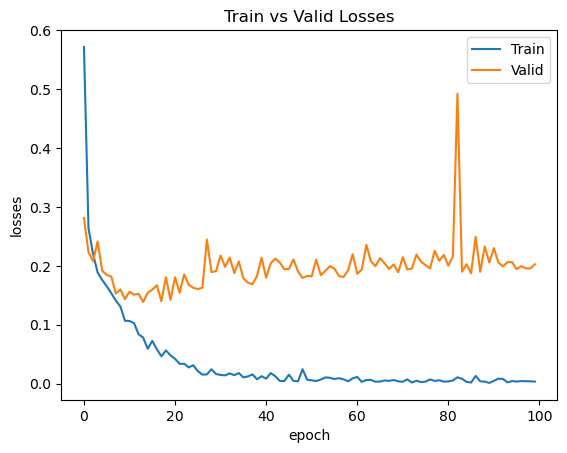

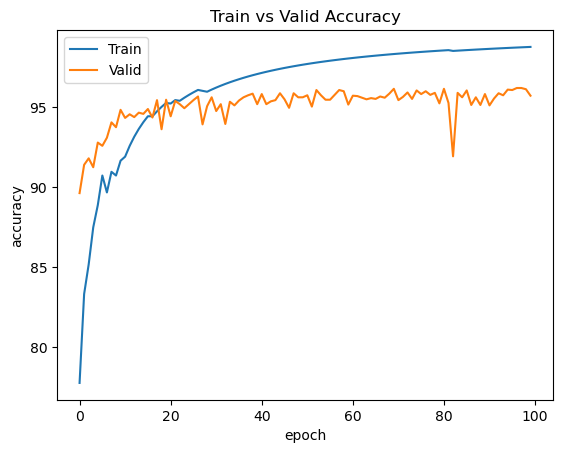

In [ ]:
from IPython.display import display, HTML, Audio, Image
from IPython.core.display import HTML

import collections
import gc
epoch_print_gap = 1

#| train_validate_graph_raytune_54dfb_00002 | TERMINATED | 172.28.0.12:73784  |       0.95 |         1e-05  | 0.001  |           32 | 0.205234 |    96.1344 |                  100 |

#batch size is already set as 32 train_nucleus_dataloader.batch_size =32

# clear cache every run to handle kaggle disconnect issue
gc.collect()
torch.cuda.empty_cache()

# learning rate
lr=0.001

# l2 regularization
weight_decay = 1e-05

# momentum
momentum = 0.95

# number of epochs
n_epochs = 100

# train model
model = train_validate_graph(
    n_epochs = n_epochs,
    model = model_cnn_1(),
    device = device,
    lr = lr,
    momentum = momentum,
    weight_decay = weight_decay,
    train_loader = train_nucleus_dataloader,
    val_loader=val_nucleus_dataloader,
    weights_init=None,
)

# alarm when model training is finished
wave = np.sin(2*np.pi*560*np.arange(200_000*2)/50_000)
Audio(wave,rate=30_000,autoplay=True)

Based on the two graphs above, we observe that the accuracy of the training data increases up to almost 99%, while the validation accuracy does not increase much. This suggests that the model is overfitting the training data. To address this issue, we can try increasing the weight decay value or using Lasso decay, which sets some weights to zero. By doing so, we were able to achieve a good accuracy score of around 96%.

Evaluate our model again on validation data and display the score

In [ ]:
validation_loop(model,device,val_nucleus_dataloader)


 Average loss: -27.3340, Accuracy: 3792/3958 (96%)



Lets save the model, so we can load it easily later when we need it :)

In [ ]:
# Save model
torch.save(model, "model_task1.pt")
#load_model_task1 = torch.load("model_task1.pt")

## ***Confusion Matrix***

Lets plot confusion matrix and class accuracies to see how our model performs on the validation set

Class of each type:  Accuracy:  tensor([95.6801, 93.3464, 98.0788, 96.0347])


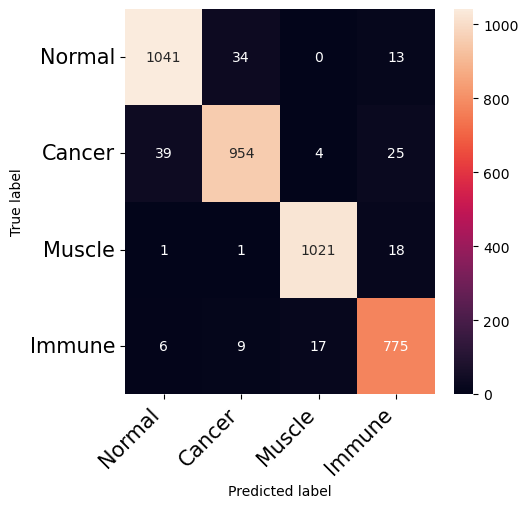

In [ ]:
import seaborn as sns

# number of classes 'Normal','Cancer','Muscle','Immune'
numberofclasses = 4

# run predict on the model
confusion_matrix = torch.zeros(numberofclasses, numberofclasses)
with torch.no_grad():
    for i, inputs in enumerate(val_nucleus_dataloader):
        classes = inputs['label'].to(device)
        inputs = inputs['image'].to(device)
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        for t, p in zip(classes.view(-1), preds.view(-1)):
                confusion_matrix[t.long(), p.long()] += 1

plt.figure(figsize=(5,5))

# define classes a string to show on confusion matrix
class_names = list(['Normal','Cancer','Muscle','Immune'])

df_cm = pd.DataFrame(confusion_matrix, index=class_names, columns=class_names).astype(int)
heatmap = sns.heatmap(df_cm, annot=True, fmt="d")
heatmap.yaxis.set_ticklabels(heatmap.yaxis.get_ticklabels(), rotation=0, ha='right',fontsize=15)
heatmap.xaxis.set_ticklabels(heatmap.xaxis.get_ticklabels(), rotation=45, ha='right',fontsize=15)
plt.ylabel('True label')
plt.xlabel('Predicted label')

# Show each class accuracy
class_accuracy=100*confusion_matrix.diagonal()/confusion_matrix.sum(1)# sum each row
print("Class of each type:  Accuracy: ", class_accuracy)

From the above confusion matrix, it is evident that the model correctly predicted around 93% of cancer cells, and most of the wrongly predicted cancer cells were classified as normal and immune cells. To address this issue, we can generate more cancer cells to improve the model's ability to learn the features of cancer cells. Alternatively, we could adjust the CNN layer to focus more on local small pixels. By tweaking the CNN layer through trial and error, I managed to improve the accuracy for each class, resulting in better performance overall.

# Captum interpretation (Gradient-based attribution)

Compute attributions using Integrated Gradients and visualize them on the image. Integrated gradients computes the integral of the gradients of the output of the model for the predicted class `preds` with respect to the input image pixels along the path from the black image to our input image. Because of large memory required we will only show sample of the data

In [ ]:
# helper method to show batch images for captum after transform
def show_transform_images_captum(images,labels,batch_size):
    fig = plt.figure(figsize = (25,5))
    for i in range(batch_size):
        ax = fig.add_subplot(2 , int(batch_size/2) , i+1, xticks = [] , yticks = [])
        image=transform(images[i])
        ax.imshow(np.transpose(image.squeeze().cpu().detach().numpy()))
        #ax.imshow(image.transpose(2,1,0).squeeze())
        temp_label=labels[i]
        if temp_label == 0:
            ax.set_title('Normal#{}'.format(temp_label))
        if temp_label == 1:
            ax.set_title('Cancer#{}'.format(temp_label))
        if temp_label == 2:
            ax.set_title('Muscle#{}'.format(temp_label))
        if temp_label == 3:
            ax.set_title('Immune#{}'.format(temp_label))
    plt.tight_layout()

import collections
import gcBefore using Captum,and since GPU is almost full from what we did before its better to clear the cache up and keep the model

In [ ]:
import collections
import gc

model.cpu()
#del model, checkpoint
# clear cache every run to handle kaggle disconnect issue
gc.collect()
torch.cuda.empty_cache()

First we will have to obtain the predictions for each image using our model, then visualize the image and corresponding attributions by overlaying the latter on the image

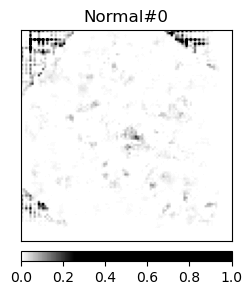

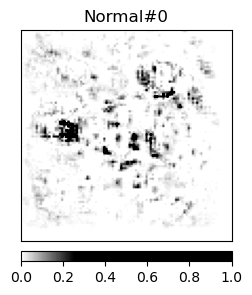

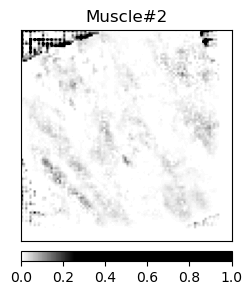

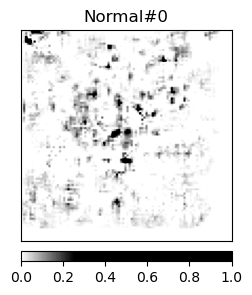

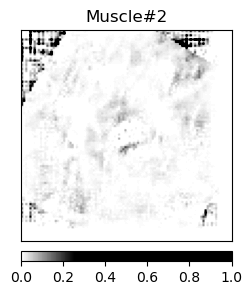

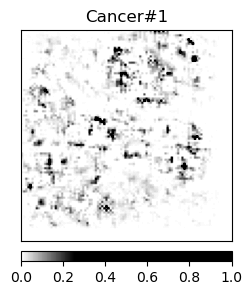

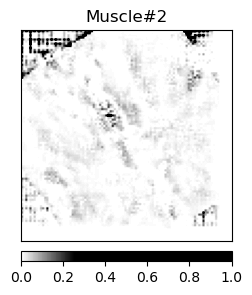

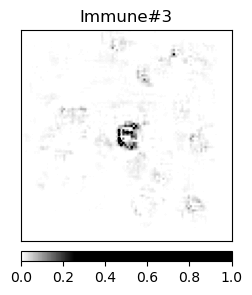

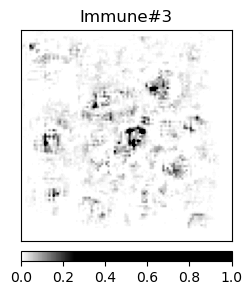

In [ ]:
from captum.attr import IntegratedGradients
from captum.attr import GradientShap
from captum.attr import Occlusion
from captum.attr import NoiseTunnel
from captum.attr import visualization as viz
from matplotlib.colors import LinearSegmentedColormap


# bring back our model to GPU
model=model.to(device)

integrated_gradients = IntegratedGradients(model)

#loop around each batch and compute the integrated gradient for the first batch only then break
with torch.no_grad():
    for i, inputs in enumerate(val_nucleus_dataloader):
        classes = inputs['label'].to(device)
        inputs = inputs['image'].to(device)
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        attributions_ig = integrated_gradients.attribute(inputs, target=preds, n_steps=10)
        #show images
        for i in range(len(attributions_ig)):
            default_cmap = LinearSegmentedColormap.from_list('custom blue',
                                                 [(0, '#ffffff'),
                                                  (0.25, '#000000'),
                                                  (1, '#000000')], N=256)
            temp_label=preds[i]
            if temp_label == 0:
                temp_label='Normal#{}'.format(temp_label)
            if temp_label == 1:
                temp_label='Cancer#{}'.format(temp_label)
            if temp_label == 2:
                temp_label='Muscle#{}'.format(temp_label)
            if temp_label == 3:
                temp_label='Immune#{}'.format(temp_label)
            _ = viz.visualize_image_attr(np.transpose(attributions_ig[i].squeeze().cpu().detach().numpy(), (1,2,0)),
                             np.transpose(inputs[i].squeeze().cpu().detach().numpy(), (1,2,0)),
                             method='heat_map',
                             cmap=default_cmap,
                             show_colorbar=True,
                             sign='positive',
                             outlier_perc=1,
                             fig_size=(3,3),title=temp_label)
            #show only 8, if more showed, kaggle wont be able to save the notebook
            if i==8:
                break
        break

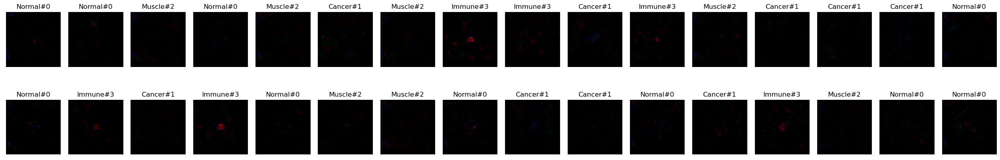

In [ ]:
show_batch_images(inputs,preds,32)

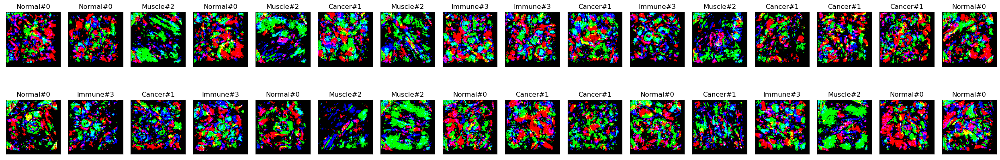

In [ ]:
show_transform_images_captum(attributions_ig,preds,32)

In [ ]:
model.cpu()
#del model, checkpoint
# clear cache every run to handle kaggle disconnect issue
gc.collect()
torch.cuda.empty_cache()

Now, lets compute attributions using Integrated Gradients and smoothens them across multiple images generated by a <em>noise tunnel</em>. The latter adds gaussian noise with a std equals to one, 1 times (nt_samples=1) to the input. Ultimately, noise tunnel smoothens the attributions across `nt_samples` noisy samples using `smoothgrad_sq` technique. `smoothgrad_sq` represents the mean of the squared attributions across `nt_samples` samples.
I couldn't run the below code with ```nt_samples``` more than ``1`` because of no avaliable GPU resources, I even tried to clear gpu cache but still i get the same issue.

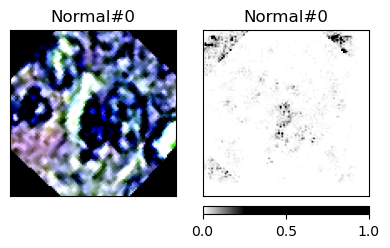

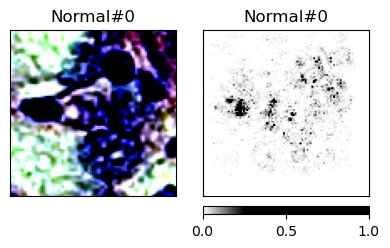

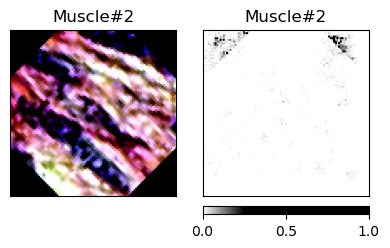

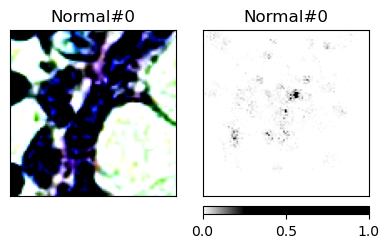

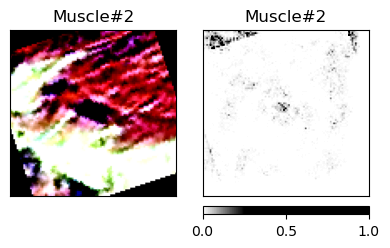

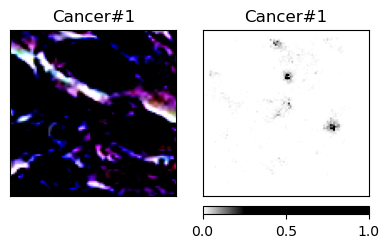

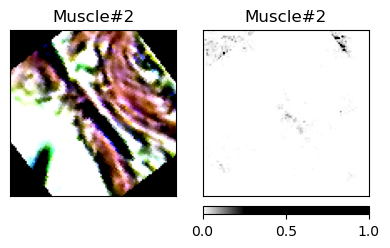

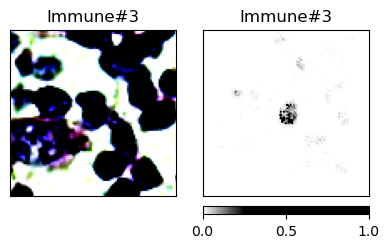

In [ ]:
# bring back our model to GPU
model=model.to(device)

noise_tunnel = NoiseTunnel(integrated_gradients)

#loop around each batch and compute the integrated gradient for the first batch only then break
with torch.no_grad():
    for i, inputs in enumerate(val_nucleus_dataloader):
        classes = inputs['label'][0:8].to(device)
        inputs = inputs['image'][0:8].to(device)
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        attributions_ig_nt = noise_tunnel.attribute(inputs, nt_samples=1, nt_type='smoothgrad_sq', target=preds)
        #show images
        for i in range(len(attributions_ig_nt)):
            temp_label=preds[i]
            if temp_label == 0:
                temp_label=['Normal#{}'.format(temp_label),'Normal#{}'.format(temp_label)]
            if temp_label == 1:
                temp_label=['Cancer#{}'.format(temp_label),'Cancer#{}'.format(temp_label)]
            if temp_label == 2:
                temp_label=['Muscle#{}'.format(temp_label),'Muscle#{}'.format(temp_label)]
            if temp_label == 3:
                temp_label=['Immune#{}'.format(temp_label),'Immune#{}'.format(temp_label)]

            _ = viz.visualize_image_attr_multiple(np.transpose(attributions_ig_nt[i].squeeze().cpu().detach().numpy(), (1,2,0)),
                                      np.transpose(inputs[i].squeeze().cpu().detach().numpy(), (1,2,0)),
                                      ["original_image", "heat_map"],
                                      ["all", "positive"],
                                      cmap=default_cmap,
                                      show_colorbar=True,
                                      fig_size=(4,4),titles=temp_label)
            #show only 8, if more showed, kaggle wont be able to save the notebook
            if i==8:
                break
        break


We can see from above some main charastrstrics help determine the class of the imageas we can see at the last immune class image at center black circle. we cant really see much since `nt_samples` was only set to 1

In [ ]:
model.cpu()
#del model, checkpoint
# clear cache every run to handle kaggle disconnect issue
gc.collect()
torch.cuda.empty_cache()

Finally, let us use `GradientShap`, a linear explanation model which uses a distribution of reference samples (in this case two images) to explain predictions of the model. It computes the expectation of gradients for an input which was chosen randomly between the input and a baseline. The baseline is also chosen randomly from given baseline distribution.

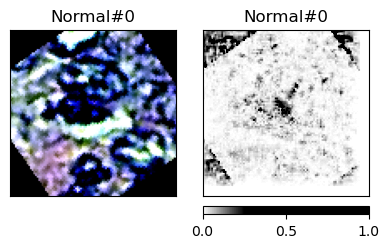

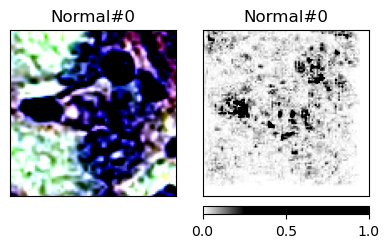

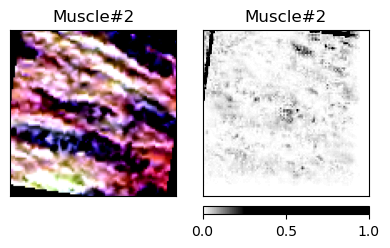

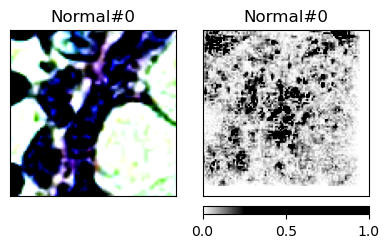

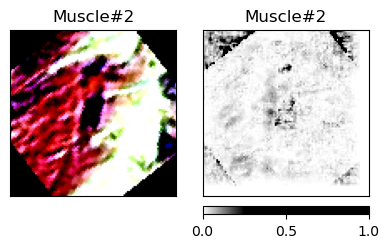

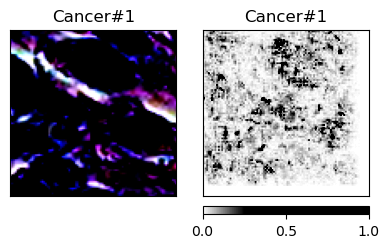

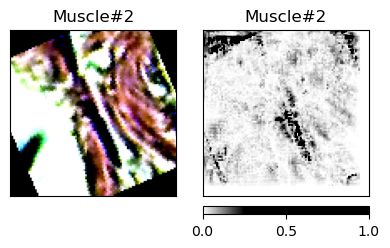

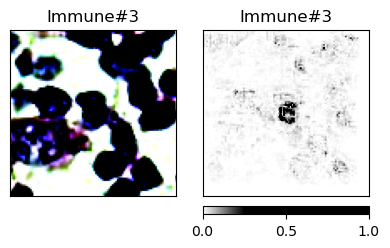

In [ ]:
torch.manual_seed(0)
np.random.seed(0)

# bring back our model to GPU
model=model.to(device)

gradient_shap = GradientShap(model)



#loop around each batch and compute the integrated gradient for the first batch only then break
with torch.no_grad():
    for i, inputs in enumerate(val_nucleus_dataloader):
        classes = inputs['label'][0:8].to(device)
        inputs = inputs['image'][0:8].to(device)
        # Defining baseline distribution of images
        rand_img_dist = torch.cat([inputs * 0, inputs * 1])
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        attributions_gs = gradient_shap.attribute(inputs,
                                          n_samples=50,
                                          stdevs=0.0001,
                                          baselines=rand_img_dist,
                                          target=preds)
        #show images
        for i in range(len(attributions_gs)):
            temp_label=preds[i]
            if temp_label == 0:
                temp_label=['Normal#{}'.format(temp_label),'Normal#{}'.format(temp_label)]
            if temp_label == 1:
                temp_label=['Cancer#{}'.format(temp_label),'Cancer#{}'.format(temp_label)]
            if temp_label == 2:
                temp_label=['Muscle#{}'.format(temp_label),'Muscle#{}'.format(temp_label)]
            if temp_label == 3:
                temp_label=['Immune#{}'.format(temp_label),'Immune#{}'.format(temp_label)]

            _ = viz.visualize_image_attr_multiple(np.transpose(attributions_gs[i].squeeze().cpu().detach().numpy(), (1,2,0)),
                                      np.transpose(inputs[i].squeeze().cpu().detach().numpy(), (1,2,0)),
                                      ["original_image", "heat_map"],
                                      ["all", "absolute_value"],
                                      cmap=default_cmap,
                                      show_colorbar=True, fig_size=(4,4),titles=temp_label)
            #show only 8, if more showed, kaggle wont be able to save the notebook
            if i==8:
                break
        break


`GradientShap` can really show different and clear indication of how each class is determined as above images shows

#### Finally, we train our model on test images and obtain the submission.csv, then submit it to kaggle :)

In [ ]:
test_accuracy_and_submit(model)

,Filename,Label
0,10001.png,3
1,10002.png,3
2,10003.png,2
3,10004.png,3
4,10005.png,3
...,...,...
5036,15037.png,1
5037,15038.png,1
5038,15039.png,0
5039,15040.png,2


Below are the result obtained after submitting model 1

![Screenshot 2023-03-25 at 7.36.27 AM.png](attachment:ef8a60be-368d-412e-b982-747050a6e561.png)

# Task 2: pre-trained torchvision model

Loading the model ResNet50, transfer learning is a way to apply the same features to our own dataset is by replacing the final layer with a few layers of our own.

In [ ]:
import torchvision
from torchvision import models
from torchvision import transforms

resnet_50 = models.resnet50(pretrained=True)

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

We will build our own head or tail few layers on top ResNet50

In [ ]:
from torch import nn

in_features = resnet_50.fc.in_features
num_hidden = 512

head = nn.Sequential(
    nn.AdaptiveAvgPool2d(1),
    nn.Flatten(),
    nn.BatchNorm1d(in_features),
    nn.Dropout(0.5),
    nn.Linear(in_features=in_features, out_features=num_hidden),
    nn.ReLU(),
    nn.BatchNorm1d(num_hidden),
    nn.Dropout(0.5),
    nn.Linear(in_features=num_hidden, out_features=4),
)

model = nn.Sequential(nn.Sequential(*list(resnet_50.children())[:-2]),head)

Since we created our model, now we can start trainning it using Ray Tune same as what we did in task 1 !

In [ ]:
from IPython.display import display, HTML, Audio, Image
from IPython.core.display import HTML

def main(num_samples=10, max_num_epochs=10, gpus_per_trial=2):
    config = {
            "momentum": tune.choice([0.99, 0.97, 0.95, 0.9]),
            "weight_decay": tune.choice([0,1e-3, 1e-4, 1e-5]),
            "lr": tune.choice([1e-4,1e-2,1e-3]),
            "batch_size": tune.choice([8,16,32])
        }

    scheduler = ASHAScheduler(
        metric="loss",
        mode="min",
        max_t=max_num_epochs,
        grace_period=1,
        reduction_factor=2)


    reporter = CLIReporter(
        parameter_columns=["momentum", "weight_decay", "lr", "batch_size"],
        metric_columns=["loss", "accuracy", "training_iteration"])

    result = tune.run(
        partial(train_validate_graph_raytune, data_dir=None, n_epochs=max_num_epochs,model=model,train_set=train_set,val_set=val_set,weights_init=None),
        resources_per_trial={"cpu": 1, "gpu": gpus_per_trial},
        config=config,
        num_samples=num_samples,
        scheduler=scheduler,
        progress_reporter=reporter)

    best_trial = result.get_best_trial("loss", "min", "last")
    print("Best trial config: {}".format(best_trial.config))
    print("Best trial final validation loss: {}".format(
            best_trial.last_result["loss"]))
    print("Best trial final validation accuracy: {}".format(
            best_trial.last_result["accuracy"]))

    best_trained_model = model

    device = "cpu"
    if torch.cuda.is_available():
        device = "cuda:0"
        if gpus_per_trial > 1:
            best_trained_model = nn.DataParallel(best_trained_model)
    best_trained_model.to(device)

    best_checkpoint_dir = best_trial.checkpoint.dir_or_data
    model_state, optimizer_state = torch.load(os.path.join(
            best_checkpoint_dir, "checkpoint"))
    best_trained_model.load_state_dict(model_state)

    best_trained_model.eval()
    test_accuracy_and_submit(best_trained_model)

    return best_trained_model

if __name__ == "__main__":
    # You can change the number of GPUs per trial here:
    best_trained_model= main(num_samples=10, max_num_epochs=100, gpus_per_trial=1)

      # alarm when model training is finished
    wave = np.sin(2*np.pi*560*np.arange(200_000*2)/50_000)
    Audio(wave,rate=30_000,autoplay=True)

2023-03-26 01:01:08,275	WARNING worker.py:1851 -- Warning: The actor ImplicitFunc is very large (94 MiB). Check that its definition is not implicitly capturing a large array or other object in scope. Tip: use ray.put() to put large objects in the Ray object store.
2023-03-26 01:01:09,049	WARNING util.py:244 -- The `start_trial` operation took 3.685 s, which may be a performance bottleneck.


== Status ==
Current time: 2023-03-26 01:01:09 (running for 00:00:20.73)
Memory usage on this node: 2.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: None | Iter 2.000: None | Iter 1.000: None
Resources requested: 1.0/2 CPUs, 1.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (9 PENDING, 1 RUNNING)
+------------------------------------------+----------+----------------+------------+----------------+--------+--------------+
| Trial name                               | status   | loc            |   momentum |   weight_decay |     lr |   batch_size |
|------------------------------------------+----------+----------------+------------+----------------+--------+--------------|
| train_validate_graph_raytune_a54c8_00000 | RUNNING  | 172.19.2.2:465 |       0.9

2023-03-26 01:01:16,917	WARNING util.py:244 -- The `start_trial` operation took 1.357 s, which may be a performance bottleneck.
(func pid=465) /opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
(func pid=465)   cpuset_checked))
(func pid=465) E0326 01:01:20.769489081     500 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:01:16 (running for 00:00:28.58)
Memory usage on this node: 2.9/15.6 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: None | Iter 2.000: None | Iter 1.000: None
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (8 PENDING, 2 RUNNING)
+------------------------------------------+----------+----------------+------------+----------------+--------+--------------+
| Trial name                               | status   | loc            |   momentum |   weight_decay |     lr |   batch_size |
|------------------------------------------+----------+----------------+------------+----------------+--------+--------------|
| train_validate_graph_raytune_a54c8_00000 | RUNNING  | 172.19.2.2:465 |       0.9

(func pid=503) /opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
(func pid=503)   cpuset_checked))
(func pid=503) E0326 01:01:29.820955718     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:01:32 (running for 00:00:43.94)
Memory usage on this node: 7.0/15.6 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: None | Iter 2.000: None | Iter 1.000: None
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (8 PENDING, 2 RUNNING)
+------------------------------------------+----------+----------------+------------+----------------+--------+--------------+
| Trial name                               | status   | loc            |   momentum |   weight_decay |     lr |   batch_size |
|------------------------------------------+----------+----------------+------------+----------------+--------+--------------|
| train_validate_graph_raytune_a54c8_00000 | RUNNING  | 172.19.2.2:465 |       0.9

Trial name,accuracy,date,done,episodes_total,experiment_id,hostname,iterations_since_restore,loss,node_ip,pid,should_checkpoint,time_since_restore,time_this_iter_s,time_total_s,timestamp,timesteps_since_restore,timesteps_total,training_iteration,trial_id,warmup_time
train_validate_graph_raytune_a54c8_00000,83.2996,2023-03-26_01-05-36,True,,e05b7863797e4298875f8a300b86777f,a2225c0d2ee4,1,0.506218,172.19.2.2,465,True,261.223,261.223,261.223,1679792736,0,,1,a54c8_00000,0.00468445
train_validate_graph_raytune_a54c8_00001,98.282,2023-03-26_03-28-43,True,,c8fd593a28b642aba8fdd9164d9428e9,a2225c0d2ee4,100,0.0778231,172.19.2.2,503,True,8836.34,89.2024,8836.34,1679801323,0,,100,a54c8_00001,0.00943136
train_validate_graph_raytune_a54c8_00002,98.8883,2023-03-26_03-35-14,True,,40967508dfab44e6935980d26c0e99f5,a2225c0d2ee4,100,0.053897,172.19.2.2,1578,True,8958.77,83.4961,8958.77,1679801714,0,,100,a54c8_00002,0.0105855
train_validate_graph_raytune_a54c8_00003,38.2264,2023-03-26_03-33-23,True,,ba456ffa2ba7435ea00aa8fbf9d3c6a7,a2225c0d2ee4,1,1.85732e+08,172.19.2.2,42169,True,253.64,253.64,253.64,1679801603,0,,1,a54c8_00003,0.0053277
train_validate_graph_raytune_a54c8_00004,93.9869,2023-03-26_03-36-45,True,,23a95b3330f544549cbcd347458f11ae,a2225c0d2ee4,2,0.158307,172.19.2.2,43405,True,180.574,77.7132,180.574,1679801805,0,,2,a54c8_00004,0.00705743
train_validate_graph_raytune_a54c8_00005,86.7863,2023-03-26_03-37-43,True,,d42731c2692445d7a24f221f14223423,a2225c0d2ee4,1,2.75354,172.19.2.2,43985,True,133.246,133.246,133.246,1679801863,0,,1,a54c8_00005,0.00875378
train_validate_graph_raytune_a54c8_00006,72.0061,2023-03-26_03-39-00,True,,9b96a19b1f774d14af1cffecaf336eff,a2225c0d2ee4,1,10.5307,172.19.2.2,44365,True,119.21,119.21,119.21,1679801940,0,,1,a54c8_00006,0.0134366
train_validate_graph_raytune_a54c8_00007,94.9469,2023-03-26_03-44-03,True,,37801bb3b71c40f08867f4e8b54b0fb3,a2225c0d2ee4,2,0.160607,172.19.2.2,44663,True,363.555,174.53,363.555,1679802243,0,,2,a54c8_00007,0.014431
train_validate_graph_raytune_a54c8_00008,93.6331,2023-03-26_03-45-17,True,,ef7eea5620de4cd7b455b66acfc0209a,a2225c0d2ee4,2,0.174534,172.19.2.2,44978,True,361.832,178.747,361.832,1679802317,0,,2,a54c8_00008,0.0215919
train_validate_graph_raytune_a54c8_00009,96.8166,2023-03-26_03-57-25,True,,2df1ce79dcbe4adda4b2d62c64bd4981,a2225c0d2ee4,8,0.100212,172.19.2.2,45843,True,786.205,93.1132,786.205,1679803045,0,,8,a54c8_00009,0.00693417


== Status ==
Current time: 2023-03-26 01:02:49 (running for 00:02:00.96)
Memory usage on this node: 8.2/15.6 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: None | Iter 2.000: None | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (8 PENDING, 2 RUNNING)
+------------------------------------------+----------+----------------+------------+----------------+--------+--------------+---------+------------+----------------------+
| Trial name                               | status   | loc            |   momentum |   weight_decay |     lr |   batch_size |    loss |   accuracy |   training_iteration |
|------------------------------------------+----------+----------------+------------+----------------

(func pid=503) E0326 01:03:38.374564261     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:03:38.415579809     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:03:39 (running for 00:02:51.10)
Memory usage on this node: 8.1/15.6 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: None | Iter 2.000: None | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (8 PENDING, 2 RUNNING)
+------------------------------------------+----------+----------------+------------+----------------+--------+--------------+---------+------------+----------------------+
| Trial name                               | status   | loc            |   momentum |   weight_decay |     lr |   batch_size |    loss |   accuracy |   training_iteration |
|------------------------------------------+----------+----------------+------------+----------------

(func pid=503) E0326 01:03:54.216944381     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:03:59 (running for 00:03:10.77)
Memory usage on this node: 8.2/15.6 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: None | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (8 PENDING, 2 RUNNING)
+------------------------------------------+----------+----------------+------------+----------------+--------+--------------+----------+------------+----------------------+
| Trial name                               | status   | loc            |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration |
|------------------------------------------+----------+----------------+-----------

(func pid=503) E0326 01:04:47.735369600     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:04:47.964791134     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:04:48.061107244     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:04:48.191602586     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:04:49 (running for 00:04:00.89)
Memory usage on this node: 8.2/15.6 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: None | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (8 PENDING, 2 RUNNING)
+------------------------------------------+----------+----------------+------------+----------------+--------+--------------+----------+------------+----------------------+
| Trial name                               | status   | loc            |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration |
|------------------------------------------+----------+----------------+-----------

(func pid=465) E0326 01:04:54.843703237     500 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=465) E0326 01:04:55.034087178     500 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=465) E0326 01:04:55.291879250     500 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:04:59 (running for 00:04:10.91)
Memory usage on this node: 8.2/15.6 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: None | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (8 PENDING, 2 RUNNING)
+------------------------------------------+----------+----------------+------------+----------------+--------+--------------+----------+------------+----------------------+
| Trial name                               | status   | loc            |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration |
|------------------------------------------+----------+----------------+-----------

(func pid=503) E0326 01:05:04.732812125     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:05:09 (running for 00:04:21.05)
Memory usage on this node: 8.2/15.6 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: None | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (8 PENDING, 2 RUNNING)
+------------------------------------------+----------+----------------+------------+----------------+--------+--------------+---------+------------+----------------------+
| Trial name                               | status   | loc            |   momentum |   weight_decay |     lr |   batch_size |    loss |   accuracy |   training_iteration |
|------------------------------------------+----------+----------------+------------+

2023-03-26 01:05:40,668	WARNING util.py:244 -- The `start_trial` operation took 1.615 s, which may be a performance bottleneck.


== Status ==
Current time: 2023-03-26 01:05:40 (running for 00:04:52.35)
Memory usage on this node: 5.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: None | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.3612991860444634
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration |
|------------------------------------------+------------+-------

(func pid=1578) /opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
(func pid=1578)   cpuset_checked))
(func pid=1578) E0326 01:05:58.913600695    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:05:58.994627992    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:06:00 (running for 00:05:12.00)
Memory usage on this node: 6.9/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: None | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.3612991860444634
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration |
|------------------------------------------+------------+-------

(func pid=503) E0326 01:06:07.110977498     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:06:07.424886338     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:06:10 (running for 00:05:22.03)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: None | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.3612991860444634
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration |
|------------------------------------------+------------+-------

(func pid=1578) E0326 01:07:14.686588199    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:07:15.120749722    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:07:15.308191130    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:07:15 (running for 00:06:27.31)
Memory usage on this node: 8.2/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: -0.11563188478561469 | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.3612991860444634
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration |
|------------------------------------------+----

(func pid=1578) E0326 01:07:32.863318122    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:07:33.409116414    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:07:37 (running for 00:06:49.20)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: -0.11563188478561469 | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------------------------------------+-

(func pid=503) E0326 01:07:40.072208856     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:07:40.345717551     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:07:42 (running for 00:06:54.22)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: -0.11563188478561469 | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------------------------------------+-

(func pid=503) E0326 01:07:58.960110517     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:08:03 (running for 00:07:15.41)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: -0.11563188478561469 | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------------------------------------+-

(func pid=1578) E0326 01:08:44.727489696    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:08:44.881608406    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:08:48 (running for 00:08:00.53)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: -0.11563188478561469 | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------------------------------------+-

(func pid=1578) E0326 01:09:03.393662937    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:09:03.687736212    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:09:08 (running for 00:08:19.81)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: -0.11563188478561469 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------------------------------------+-

(func pid=503) E0326 01:09:12.179706105     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:09:12.597948758     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:09:13 (running for 00:08:24.82)
Memory usage on this node: 8.3/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: -0.11563188478561469 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------------------------------------+-

(func pid=503) E0326 01:09:31.005557205     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:09:35 (running for 00:08:47.26)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: -0.11563188478561469 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------------------------------------+-

(func pid=1578) E0326 01:10:13.876120913    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:10:14.134928385    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:10:14.286970485    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:10:16 (running for 00:09:27.67)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: -0.11563188478561469 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------------------------------------+-

(func pid=1578) E0326 01:10:32.606306358    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:10:32.668427621    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:10:37 (running for 00:09:49.07)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: -0.11563188478561469 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------------------------------------+-

(func pid=503) E0326 01:10:44.936466733     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:10:45.058899950     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:10:45.319407762     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:10:47 (running for 00:09:59.10)
Memory usage on this node: 8.3/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: -0.11563188478561469 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------------------------------------+-

(func pid=503) E0326 01:11:03.739276098     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:11:03.816217922     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:11:08 (running for 00:10:20.03)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: -0.11563188478561469 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------------------------------------+-

(func pid=1578) E0326 01:11:43.383483707    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:11:43 (running for 00:10:55.14)
Memory usage on this node: 8.2/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: -0.11563188478561469 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------------------------------------+-

(func pid=1578) E0326 01:11:43.836337498    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:11:43.937999159    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:11:44.077395001    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:11:48 (running for 00:11:00.15)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: -0.11563188478561469 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------------------------------------+-

(func pid=1578) E0326 01:12:01.937867009    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:12:02.446439795    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:12:06 (running for 00:11:18.54)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------------------------------------+-

(func pid=503) E0326 01:12:13.804008071     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:12:16 (running for 00:11:28.56)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: None | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------------------------------------+-

(func pid=503) E0326 01:12:31.741002260     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:12:32.446100091     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:12:36 (running for 00:11:48.29)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: -0.09992190565068713 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|----------------------------

(func pid=1578) E0326 01:13:16.374113844    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:13:16 (running for 00:12:28.40)
Memory usage on this node: 8.2/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: -0.09992190565068713 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|----------------------------

(func pid=1578) E0326 01:13:16.697448881    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:13:21 (running for 00:12:33.41)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: -0.09992190565068713 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|----------------------------

(func pid=503) E0326 01:13:43.066391305     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:13:44 (running for 00:12:55.69)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: -0.09992190565068713 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|----------------------------

(func pid=1578) E0326 01:14:48.481259072    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:14:50 (running for 00:14:01.94)
Memory usage on this node: 8.3/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: -0.09992190565068713 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|----------------------------

(func pid=1578) E0326 01:15:06.500221299    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:15:10.504048895     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:15:10.943335817     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:15:10 (running for 00:14:22.63)
Memory usage on this node: 8.2/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: -0.09992190565068713 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|----------------------------

(func pid=503) E0326 01:15:28.899678343     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:15:29.290865387     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:15:29.392356786     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:15:29.460275782     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:15:33 (running for 00:14:45.45)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: -0.09992190565068713 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|----------------------------

(func pid=1578) E0326 01:16:17.758067667    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:16:18 (running for 00:15:30.58)
Memory usage on this node: 8.3/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: -0.09992190565068713 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|----------------------------

(func pid=1578) E0326 01:16:35.716453364    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:16:39.801927918     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:16:39.933217631     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:16:40.063838037     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:16:40 (running for 00:15:52.29)
Memory usage on this node: 8.3/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: -0.09992190565068713 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|----------------------------

(func pid=503) E0326 01:16:58.893672723     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:16:59.097754870     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:17:03 (running for 00:16:15.46)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: -0.09992190565068713 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|----------------------------

(func pid=503) E0326 01:18:06.739803335     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:18:06.793606102     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:18:06.990435761     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:18:12 (running for 00:17:23.89)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|----------------------------

(func pid=1578) E0326 01:19:18.495391045    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:19:21 (running for 00:18:32.74)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|----------------------------

(func pid=503) E0326 01:19:39.383938494     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:19:39.589487040     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:19:39.749930408     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:19:40 (running for 00:18:52.29)
Memory usage on this node: 8.3/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|----------------------------

(func pid=503) E0326 01:19:57.822325917     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:20:02 (running for 00:19:14.11)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration |
|------------------------------

(func pid=1578) E0326 01:20:44.633005649    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:20:44.827049223    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:20:45.053006094    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:20:47 (running for 00:19:59.23)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |     loss |   accuracy |   training_iteration |
|------------------------------

(func pid=1578) E0326 01:21:02.077217525    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:21:07 (running for 00:20:18.74)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|----------------------------

(func pid=503) E0326 01:21:14.032913986     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:21:14.202081256     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:21:17 (running for 00:20:28.77)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|----------------------------

(func pid=503) E0326 01:21:32.566464689     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:21:32.640623751     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:21:37 (running for 00:20:48.83)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|----------------------------

(func pid=1578) E0326 01:22:32.966774056    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:22:37 (running for 00:21:49.48)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|----------------------------

(func pid=503) E0326 01:22:42.440140699     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:22:42 (running for 00:21:54.50)
Memory usage on this node: 8.2/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|----------------------------

(func pid=503) E0326 01:23:01.031038891     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:23:05 (running for 00:22:17.20)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|----------------------------

(func pid=1578) E0326 01:23:45.301508891    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:23:45.474490444    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:23:45 (running for 00:22:57.29)
Memory usage on this node: 8.3/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: None | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|----------------------------

(func pid=503) E0326 01:24:30.318639316     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:24:30.658965920     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:24:30.706083615     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:24:35 (running for 00:23:46.87)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.09029393602027772 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:25:31.989116235    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:25:36 (running for 00:24:48.32)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.09029393602027772 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:25:43.051406041     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:25:46 (running for 00:24:58.36)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.09029393602027772 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:26:01.036369227     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:26:05 (running for 00:25:17.58)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.09029393602027772 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:26:44.005031687    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:26:46 (running for 00:25:57.71)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.09029393602027772 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:27:02.534848765    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:27:03.062939130    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:27:07 (running for 00:26:19.07)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.09029393602027772 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:27:14.180856448     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:27:17 (running for 00:26:29.10)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.09029393602027772 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:27:31.906405811     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:27:32.083847172     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:27:32.208177907     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:27:36 (running for 00:26:48.56)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.09029393602027772 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:28:35.685398482    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:28:40 (running for 00:27:52.05)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.09029393602027772 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:28:58.859694455     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:28:59.355259207     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:29:03 (running for 00:28:15.51)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.09029393602027772 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:29:46.664735477    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:29:46.952130384    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:29:47.078246601    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:29:47.205741277    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:29:47.428764129    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:29:48 (running for 00:29:00.65)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.09029393602027772 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:30:03.988983397    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:30:04.102517331    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:30:04.422590587    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:30:08 (running for 00:29:20.54)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:30:30.369241015     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:30:35 (running for 00:29:46.98)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:31:16.544593736    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:31:20 (running for 00:30:32.11)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:31:34.383369799    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:31:34.472263072    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:31:39 (running for 00:30:50.82)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:31:44.111467978     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:31:49 (running for 00:31:00.85)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:32:01.293252467     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:32:01.439222221     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:32:05 (running for 00:31:17.54)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:32:47.834804995    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:32:47.982832390    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:32:48.062744264    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:32:48.255363241    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:32:51 (running for 00:32:02.67)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:33:05.295274523    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:33:05.549691292    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:33:10 (running for 00:32:21.80)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:33:12.713449269     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:33:15 (running for 00:32:26.82)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:33:31.675770534     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:33:36 (running for 00:32:47.74)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:34:17.008874311    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:34:17.289613835    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:34:17.516764890    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:34:21 (running for 00:33:32.88)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:34:35.952756780    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:34:40 (running for 00:33:52.20)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:34:42.843733792     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:34:45 (running for 00:33:57.21)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:35:02.042433821     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:35:02.216280038     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:35:02.791165968     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:35:02.949878922     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:35:07 (running for 00:34:18.69)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:35:47.950429952    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:35:48.476507234    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:35:52 (running for 00:35:03.83)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:36:06.801215283    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:36:11 (running for 00:35:22.76)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:36:13.358739085     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:36:13.492330417     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:36:16 (running for 00:35:27.78)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:37:20.504215934    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:37:20.744891782    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:37:21 (running for 00:36:33.27)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:37:39.252962711    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:37:43 (running for 00:36:55.31)
Memory usage on this node: 8.2/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:37:44.270361118     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:37:48 (running for 00:37:00.35)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:38:01.088244057     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:38:05 (running for 00:37:17.64)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:39:06.732410720    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:39:06.992082939    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:39:07.525042506    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:39:11 (running for 00:38:23.19)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:39:15.054126989     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:39:15.259052332     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:39:15.339274677     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:39:16 (running for 00:38:28.20)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:39:33.177950632     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:39:33.500836626     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:39:38 (running for 00:38:49.84)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:40:20.054008959    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:40:20.274915918    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:40:23 (running for 00:39:34.98)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:40:38.424931827    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:40:43 (running for 00:39:54.91)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:41:03.040719035     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:41:03.306967255     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:41:03.440917559     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:41:07 (running for 00:40:19.63)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:41:51.275194108    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:41:51.793044585    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:41:53 (running for 00:41:04.77)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:42:08.265698655    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:42:08.560545867    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:42:08.721114588    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:42:13 (running for 00:41:24.75)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:42:15.697740862     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:42:16.107844991     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:42:18 (running for 00:41:29.79)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:42:34.654698416     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:42:34.748930480     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:42:34.910389428     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:42:39 (running for 00:41:51.08)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:43:23.439044114    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:43:23.715307896    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:43:23.824599483    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:43:24 (running for 00:42:36.23)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:43:44.083347287     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:43:46 (running for 00:42:57.80)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:44:02.652706241     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:44:07 (running for 00:43:18.96)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:44:52.408671287    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:44:52 (running for 00:44:04.18)
Memory usage on this node: 8.3/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:44:52.719303422    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:44:53.090613605    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:44:57 (running for 00:44:09.19)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:45:16.646792177     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:45:20 (running for 00:44:32.33)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:45:34.803643155     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:45:39 (running for 00:44:51.48)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:46:21.558708251    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:46:24 (running for 00:45:36.59)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:46:41.268787045    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:46:45.517594475     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:46:45 (running for 00:45:57.35)
Memory usage on this node: 8.3/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:47:04.424608280     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:47:08 (running for 00:46:20.37)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:48:10.635955294    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:48:11.018089506    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:48:15 (running for 00:47:27.10)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=503) E0326 01:48:17.282654499     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:48:20 (running for 00:47:32.11)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: None | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration |
|------------

(func pid=1578) E0326 01:49:24.758906568    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:49:24.887945750    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:49:25.263854265    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:49:29 (running for 00:48:41.37)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.08402625763533046 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 01:49:42.403510399    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:49:46.467612987     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:49:46.684934115     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:49:47 (running for 00:48:58.79)
Memory usage on this node: 8.3/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.08402625763533046 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 01:50:04.478613631     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:50:09 (running for 00:49:20.84)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.08402625763533046 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 01:50:55.826939267    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:50:55.902331811    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:50:59 (running for 00:50:11.00)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.08402625763533046 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 01:51:13.609638810    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:51:16.321405223     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:51:16.377321248     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:51:18 (running for 00:50:30.29)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.08402625763533046 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 01:51:35.491929767     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:51:40 (running for 00:50:51.80)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.08402625763533046 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 01:52:27.529139940    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:52:30 (running for 00:51:41.94)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.08402625763533046 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 01:52:44.943512755    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:52:45.209271939    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:52:45.490101792    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:52:45.656246272     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:52:49 (running for 00:52:01.47)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.08402625763533046 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 01:53:04.759102757     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:53:05.103783311     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:53:09 (running for 00:52:21.30)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.08402625763533046 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 01:54:01.966302282    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:54:02.326055165    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:54:04 (running for 00:53:16.45)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.08402625763533046 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 01:54:11.151919003     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:54:11.656637148     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:54:11.958887838     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:54:12.156251324     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:54:14 (running for 00:53:26.48)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.08402625763533046 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 01:54:22.066726384    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:54:22.526421423    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:54:26 (running for 00:53:38.17)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 01:54:31.638777103     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:54:31.953623706     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:54:32.271793017     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:54:36 (running for 00:53:48.32)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 01:55:33.860922030    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:55:34.282355025    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:55:34.480945141    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:55:36 (running for 00:54:48.53)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 01:55:40.131318821     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:55:40.346490630     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:55:40.914118724     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:55:41 (running for 00:54:53.55)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 01:55:55.486315953    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:55:55.966449084    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


(func pid=503) Epoch: 37, Training Loss: 0.006, Validation Loss: 0.097, train accuracy = 98.630, val accuracy = 97.802
== Status ==
Current time: 2023-03-26 01:56:00 (running for 00:55:11.82)
Memory usage on this node: 8.3/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     

(func pid=503) E0326 01:56:01.173903555     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:56:01.502939368     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:56:05 (running for 00:55:17.62)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 01:57:05.439165667     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:57:05.608604019     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:57:06 (running for 00:56:17.79)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 01:57:07.887211136    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:57:08.238808370    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:57:09.057695270    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:57:11 (running for 00:56:22.81)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 01:57:26.559221358     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:57:26.674755969     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


(func pid=1578) Epoch: 34, Training Loss: 0.005, Validation Loss: 0.065, train accuracy = 99.337, val accuracy = 98.737
== Status ==
Current time: 2023-03-26 01:57:31 (running for 00:56:43.09)
Memory usage on this node: 8.3/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status    

(func pid=1578) E0326 01:57:32.285542841    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:57:37 (running for 00:56:48.98)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 01:58:45.823622909    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:58:46.464953251    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 01:58:47.031659239    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:58:47 (running for 00:57:59.18)
Memory usage on this node: 8.3/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 01:58:52.158420597     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:58:52.235593149     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:58:52.386443934     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 01:58:52.730676761     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:58:57 (running for 00:58:08.79)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 01:59:06.781226629    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 01:59:11 (running for 00:58:23.25)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:00:04.251544495     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:00:04.648296570     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:00:06 (running for 00:59:18.41)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:00:15.994316768    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:00:16.311294053    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:00:16.819324719    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:00:17 (running for 00:59:28.86)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:00:25.892031664     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:00:26.343609490     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:00:30 (running for 00:59:42.19)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:00:37.107449631    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:00:37.248660447    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:00:37.541476635    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:00:42 (running for 00:59:53.66)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:01:36.439383108     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:01:37 (running for 01:00:48.82)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:01:46.278859790    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:01:46.826023439    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:01:46.962827084    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:01:47 (running for 01:00:58.84)
Memory usage on this node: 8.3/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:01:47.353931277    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:01:52 (running for 01:01:03.86)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:02:07.030318070    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:02:11 (running for 01:01:23.57)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:03:10.446626235    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:03:10.558854542    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:03:10.884508088     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:03:10.822830277    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:03:12 (running for 01:02:23.75)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:03:33.598294550    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:03:33.744563930     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:03:38 (running for 01:02:50.22)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:04:41.602722303     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:04:41.704676763     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:04:41.951709464     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:04:42.181748376     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:04:43 (running for 01:03:55.40)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:05:03.606448743     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:05:03.835037106     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:05:03.928024428    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:05:08 (running for 01:04:20.28)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:06:10.552371608     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:06:10.674424120     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:06:10.863356115     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:06:10.954332934     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:06:13 (running for 01:05:25.50)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:06:15.982426848    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:06:16.520064689    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:06:16.660073653    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:06:17.043167512    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:06:18 (running for 01:05:30.52)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:06:32.802480652     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:06:33.351515992     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


(func pid=1578) Epoch: 40, Training Loss: 0.003, Validation Loss: 0.057, train accuracy = 99.429, val accuracy = 98.888
== Status ==
Current time: 2023-03-26 02:06:36 (running for 01:05:48.65)
Memory usage on this node: 8.3/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status    

(func pid=1578) E0326 02:06:37.186893556    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:06:42 (running for 01:05:53.66)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:07:38.850967650     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:07:39.007646189     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:07:39.110972850     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:07:42 (running for 01:06:53.85)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:07:49.011656790    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:07:49.598225581    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:07:49.924546737    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:07:52 (running for 01:07:03.88)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:07:57.176360815     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:07:57.853436310     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:08:01 (running for 01:07:13.66)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:08:10.389707759    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:08:14 (running for 01:07:26.53)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:09:20.793699100     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:09:21.093826497     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:09:24.555428681    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:09:24.985640359    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:09:25.075986798    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:09:25 (running for 01:08:37.38)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:09:41.683887404    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:09:41.905774413    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:09:42.356000210    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:09:46 (running for 01:08:57.85)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:10:34.715544855     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:10:36 (running for 01:09:48.05)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:10:53.056319081    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:10:53.710036790    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:10:54.227211253    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:10:56 (running for 01:10:08.65)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:12:03.374287350     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:12:03 (running for 01:11:15.10)
Memory usage on this node: 8.3/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:12:21.010668598     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:12:21.319744734     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:12:25 (running for 01:11:37.60)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:13:32.163976895     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:13:32.227427791     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:13:34 (running for 01:12:46.09)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:13:50.249987881     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:13:50.353333396     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:13:55 (running for 01:13:06.83)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:14:15.194308134    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:14:19 (running for 01:13:31.61)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:15:02.518169786     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:15:02.974436919     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:15:05 (running for 01:14:16.73)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:15:27.741912133    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:15:30 (running for 01:14:41.87)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:15:46.760762956    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:15:47.254621016    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:15:47.388602040    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:15:51 (running for 01:15:03.24)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:16:29.686065362     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:16:29.795358374     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:16:31 (running for 01:15:43.34)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:16:47.225882043     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:16:51 (running for 01:16:03.39)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:17:00.994588013    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:17:01.093217406    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:17:01 (running for 01:16:13.42)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:17:19.259854705    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:17:19.478249522    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:17:23 (running for 01:16:35.04)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:17:57.413618792     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:17:58 (running for 01:17:10.15)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:18:14.333347772     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:18:18 (running for 01:17:30.62)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:18:32.955394447    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:18:34 (running for 01:17:45.70)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:18:51.101089824    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:18:51.737952552    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:18:55 (running for 01:18:07.66)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:19:24.098219266     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:19:26 (running for 01:18:37.74)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:20:04.171984590    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:20:06 (running for 01:19:18.30)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:20:22.379001973    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:20:22.557490473    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:20:26 (running for 01:19:38.59)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:20:51.342171153     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:20:52 (running for 01:20:03.67)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:21:08.703117696     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:21:09.115914247     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:21:13 (running for 01:20:25.28)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:21:34.832711573    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:21:35.261090846    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:21:35.857679975    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:21:38 (running for 01:20:50.36)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:22:18.749889074     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:22:19.162573588     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:22:19.347700342     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:22:22 (running for 01:21:34.32)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:22:37.331740020     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:22:37.727064495     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:22:37.851593128     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:22:42 (running for 01:21:53.94)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:23:02.923471504    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:23:07 (running for 01:22:19.04)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:23:20.714210964    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:23:21.467298180    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:23:21.575460398    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:23:21.791384599    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:23:25 (running for 01:22:37.36)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:23:47.099805287     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:23:50 (running for 01:23:02.45)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:24:50.102980801    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:24:50.651657126    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:24:50.754879831    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:24:54 (running for 01:24:06.66)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:25:30.428234050     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:25:30.669997064     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:25:30.877691298     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:25:35 (running for 01:24:46.94)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:26:20.155405495    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:26:20.327957893    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:26:20.677791839    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:26:20.885776483    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:26:24 (running for 01:25:36.52)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:26:41.192086568     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:26:41.494862137     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:26:44 (running for 01:25:56.59)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:26:59.245628178     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:26:59.420604975     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:27:04 (running for 01:26:15.72)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:27:31.349380495    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:27:31.825745320    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:27:31.953386155    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:27:32.089587874    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:27:34 (running for 01:26:45.81)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:27:48.388690703    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:27:48.856869626    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:27:53 (running for 01:27:04.86)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:28:11.049256459     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:28:11.122842163     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:28:13 (running for 01:27:24.93)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:28:30.016438976     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:28:34 (running for 01:27:46.21)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:28:59.149049382    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:28:59 (running for 01:28:11.30)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:29:17.107764513    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:29:17.170825724    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:29:17.387897683    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:29:21 (running for 01:28:33.29)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:29:40.625596870     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:29:41.350104220     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:29:41.457217866     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:29:41 (running for 01:28:53.34)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:29:58.120646619     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:30:03 (running for 01:29:14.71)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:30:28.420383495    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:30:33 (running for 01:29:45.04)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:30:46.985295782    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:30:51 (running for 01:30:02.68)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:31:10.401573075     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:31:10.582511304     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:31:11 (running for 01:30:22.75)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:31:26.510944418     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:31:31 (running for 01:30:42.81)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:32:16.713027036    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:32:21 (running for 01:31:32.98)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:32:51.911566472     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:32:52.309648436     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:32:56 (running for 01:32:08.36)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:33:30.674883192    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:33:31 (running for 01:32:43.48)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:34:17.922701714     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:34:22 (running for 01:33:34.14)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=1578) E0326 02:34:59.641021205    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:34:59.812330496    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:35:00.273789196    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:35:02 (running for 01:34:14.26)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: None | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   training_iteration

(func pid=503) E0326 02:35:46.258438441     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:35:46.602556850     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:35:46.750233123     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:35:51 (running for 01:35:02.78)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.08126887436104377 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tr

(func pid=1578) E0326 02:36:30.782826916    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:36:31 (running for 01:35:42.93)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.08126887436104377 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tr

(func pid=1578) E0326 02:36:47.800126356    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:36:52 (running for 01:36:04.24)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.08126887436104377 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tr

(func pid=503) E0326 02:36:55.571585574     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:36:57 (running for 01:36:09.31)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.08126887436104377 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tr

(func pid=1578) E0326 02:37:58.784039828    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:37:59 (running for 01:37:10.95)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.08126887436104377 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tr

(func pid=503) E0326 02:38:26.005158241     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:38:26.252038463     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:38:31 (running for 01:37:42.76)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.08126887436104377 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tr

(func pid=503) E0326 02:38:44.281905411     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:38:48 (running for 01:38:00.56)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.08126887436104377 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tr

(func pid=1578) E0326 02:39:27.889191014    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:39:28.638567495    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:39:29 (running for 01:38:40.69)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.08126887436104377 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tr

(func pid=1578) E0326 02:39:45.959313663    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:39:46.492030745    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:39:50 (running for 01:39:02.18)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.08126887436104377 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tr

(func pid=503) E0326 02:39:54.704851834     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:39:54.929808078     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:39:55.028779373     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:39:55 (running for 01:39:07.21)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.08126887436104377 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tr

(func pid=503) E0326 02:40:13.437879934     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:40:18 (running for 01:39:29.78)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.08126887436104377 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tr

(func pid=1578) E0326 02:40:57.000251672    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:40:58 (running for 01:40:09.90)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.08126887436104377 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tr

(func pid=1578) E0326 02:41:14.959051481    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:41:19 (running for 01:40:31.53)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.08126887436104377 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tr

(func pid=503) E0326 02:41:23.939777715     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:41:24.181991736     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:41:24.699935816     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:41:24 (running for 01:40:36.54)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.08126887436104377 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tr

(func pid=1578) E0326 02:42:25.831233396    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:42:26.035689776    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:42:26 (running for 01:41:38.18)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.08126887436104377 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tr

(func pid=503) E0326 02:42:53.980763671     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:42:54.077405723     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:42:58 (running for 01:42:09.77)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 02:43:10.068290969     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:43:14 (running for 01:42:26.46)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 02:44:21.162128529     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:44:21 (running for 01:43:32.89)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 02:44:39.054895217     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:44:43 (running for 01:43:55.54)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 02:45:20.813830000    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:45:21.203913418    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:45:24 (running for 01:44:35.68)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 02:45:39.507744287    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:45:39.745851299    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:45:44 (running for 01:44:55.90)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 02:46:48.489982252    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:46:49 (running for 01:46:00.67)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 02:47:06.714689212    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:47:11 (running for 01:46:23.09)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 02:47:21.594222659     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:47:26 (running for 01:46:38.17)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 02:47:39.569094018     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:47:39.930828349     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:47:44 (running for 01:46:56.07)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 02:48:21.434879860    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:48:24 (running for 01:47:36.22)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 02:48:37.686826460    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:48:37.854899317    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:48:38.001944901    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:48:42 (running for 01:47:54.09)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 02:49:05.060834474     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:49:09 (running for 01:48:21.32)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 02:49:48.459379668    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:49:49 (running for 01:49:01.45)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 02:50:06.115933691    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:50:10 (running for 01:49:22.21)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 02:50:16.961276724     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:50:17.213626123     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:50:20 (running for 01:49:32.29)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 02:51:15.651328215    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:51:20 (running for 01:50:32.13)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 02:51:33.936436731    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:51:38 (running for 01:50:50.02)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 02:51:47.721055369     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:51:47.918471287     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:51:48 (running for 01:51:00.07)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 02:52:05.756424853     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:52:10 (running for 01:51:22.18)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 02:52:43.936937487    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:52:45 (running for 01:51:57.33)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 02:53:02.978101748    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:53:07 (running for 01:52:19.23)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 02:53:16.250889323     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:53:17 (running for 01:52:29.26)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 02:54:12.379791082    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:54:12.657033465    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:54:15 (running for 01:53:26.95)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 02:54:30.352857822    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:54:30.551269255    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:54:30.924657842    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:54:35 (running for 01:53:46.99)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 02:54:45.055511449     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:54:45 (running for 01:53:57.03)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 02:54:45.401370573     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:54:50 (running for 01:54:02.05)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 02:55:04.189804176     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:55:04.244368125     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:55:08 (running for 01:54:20.53)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 02:55:40.517650831    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:55:40.598083616    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:55:43 (running for 01:54:55.63)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 02:55:58.076177168    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:55:58.725981806    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:56:02 (running for 01:55:14.55)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 02:56:30.495833532     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:56:30.617387109     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:56:30.706741913     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:56:30.780054918     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:56:35 (running for 01:55:47.05)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 02:57:09.947209033    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:57:10 (running for 01:56:22.17)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 02:57:28.176391401    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 02:57:28.306897201    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:57:32 (running for 01:56:44.54)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 02:57:39.875955006     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:57:40.099121796     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:57:42 (running for 01:56:54.62)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 02:57:56.843670107     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:57:57.178606690     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 02:57:57.389291830     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:58:01 (running for 01:57:13.42)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 02:58:39.839071221    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 02:58:41 (running for 01:57:53.55)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:00:08.746613744    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:00:09.230924165    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:00:10 (running for 01:59:22.61)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:00:27.046292504    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:00:27.225646478    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:00:31 (running for 01:59:43.54)
Memory usage on this node: 8.8/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:00:36.854598826     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:00:36.975203942     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:00:36 (running for 01:59:48.58)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:01:37.936585201    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:01:38.087829426    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:01:38.212592638    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:01:38.561384290    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:01:40 (running for 02:00:52.54)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:01:56.396304517    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:01:56.929417573    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:01:57.095494921    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:02:01 (running for 02:01:12.69)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:02:03.100384073     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:02:06 (running for 02:01:17.69)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:02:20.924388443     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:02:21.133428288     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:02:25 (running for 02:01:37.27)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:03:08.735635759    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:03:10 (running for 02:02:22.44)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:03:26.301422902    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:03:26.427501126    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:03:31 (running for 02:02:42.70)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:04:37.254610764    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:04:37.705118881    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:04:37.783325097    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:04:38 (running for 02:03:50.50)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:04:54.328507735    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:04:59 (running for 02:04:10.90)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:05:00.932414445     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:05:04 (running for 02:04:15.91)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:06:08.011250218    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:06:12 (running for 02:05:24.60)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:06:25.950145779     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:06:29 (running for 02:05:41.33)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:07:35.140394507    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:07:35.790432603    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:07:40 (running for 02:06:51.76)
Memory usage on this node: 8.8/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:07:55.297841419     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:07:55.681905679     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:07:55.941622908     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:07:57 (running for 02:07:09.62)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:08:13.036079536     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:08:17 (running for 02:07:29.38)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:09:24.808644026    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:09:24.904963312    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:09:25.112584094    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:09:25.596685492    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:09:29 (running for 02:08:41.15)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:09:38.900037579     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:09:39.319282678     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:09:39.724716232     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:09:39.916085076     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:09:43 (running for 02:08:55.47)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:10:46.698363897     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:10:49 (running for 02:10:00.68)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:10:56.459271619    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:10:57.044598072    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:11:01 (running for 02:10:13.15)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:11:05.878000120     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:11:05.995178016     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:11:10 (running for 02:10:22.00)
Memory usage on this node: 8.8/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:12:12.536450166     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:12:12.935692417     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:12:13.676220373     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:12:15 (running for 02:11:27.24)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:12:24.765409482    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:12:29 (running for 02:11:41.31)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:12:32.620359090     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:12:32.844700397     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:12:33.007448909     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:12:37 (running for 02:11:49.22)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:13:36.164432021    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:13:37.630655593     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:13:37 (running for 02:12:49.43)
Memory usage on this node: 8.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:13:38.191637197     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:13:38.428722563     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:13:42 (running for 02:12:54.45)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:13:58.971949272    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


(func pid=503) Epoch: 90, Training Loss: 0.003, Validation Loss: 0.085, train accuracy = 99.379, val accuracy = 98.029


(func pid=503) E0326 03:14:00.515646633     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:14:00.955096114     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:14:05 (running for 02:13:17.11)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:15:11.094986447    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:15:11.253095292    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:15:15 (running for 02:14:27.31)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:16:32.921766019     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:16:33.019860228     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:16:33.372530104     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:16:33.562653884     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:16:37 (running for 02:15:49.39)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:16:45.965964835    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:16:46.489869119    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:16:47 (running for 02:15:59.42)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:17:04.922327884    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:17:09 (running for 02:16:21.36)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:18:04.070848988     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:18:04 (running for 02:17:16.55)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:18:14.222673743    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:18:14.367239776    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:18:14.749906323    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:18:14 (running for 02:17:26.57)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:18:25.700564115     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:18:30 (running for 02:17:42.03)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:19:50.902862721     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:19:51.149137676     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:19:55 (running for 02:19:07.05)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:20:09.883206621    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:20:14 (running for 02:19:26.58)
Memory usage on this node: 8.9/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:21:03.897179168     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:21:03.945872731     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:21:05 (running for 02:20:16.72)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:21:21.074069836     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:21:21.133913087     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:21:21.779000022    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:21:25 (running for 02:20:37.50)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:21:41.437985240    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:21:46 (running for 02:20:57.79)
Memory usage on this node: 8.8/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:22:34.576208331     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:22:36 (running for 02:21:47.94)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:22:50.666073297    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:22:50.800804309    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:22:51.115963041     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:22:51.304424841     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:22:51.256312095    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:22:51.437279688     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:22:51.526911280    1625 fork_posix.cc:76]           Other threads are currently call

== Status ==
Current time: 2023-03-26 03:22:55 (running for 02:22:07.40)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:23:10.370146478    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:23:15 (running for 02:22:26.76)
Memory usage on this node: 8.8/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:24:02.020435632     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:24:02.289203682     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:24:05 (running for 02:23:16.91)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:24:21.401673124    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:24:24 (running for 02:23:36.49)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:24:39.757398398    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:24:44 (running for 02:23:56.32)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:25:28.777315221     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:25:29.283424537     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:25:29 (running for 02:24:41.45)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:25:47.591214249     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:25:47.719594206     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:25:47.877143931     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:25:52 (running for 02:25:03.81)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:25:53.734029967    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:25:57 (running for 02:25:08.85)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:26:11.743973651    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:26:16 (running for 02:25:28.00)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:27:14.491831587     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:27:19 (running for 02:26:31.12)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:27:26.526495281    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:27:26.682847477    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:27:29 (running for 02:26:41.18)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=1578) E0326 03:27:44.635409573    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:27:49 (running for 02:27:01.15)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

(func pid=503) E0326 03:28:26.448348887     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=503) E0326 03:28:26.694467656     636 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:28:29 (running for 02:27:41.27)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (7 PENDING, 2 RUNNING, 1 TERMINATED)
+------------------------------------------+------------+-----------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc             |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   tra

2023-03-26 03:28:49,306	WARNING util.py:244 -- The `start_trial` operation took 1.464 s, which may be a performance bottleneck.
(func pid=1578) E0326 03:28:55.558454118    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


(func pid=1578) Epoch: 95, Training Loss: 0.000, Validation Loss: 0.054, train accuracy = 99.739, val accuracy = 99.065
== Status ==
Current time: 2023-03-26 03:28:49 (running for 02:28:00.98)
Memory usage on this node: 5.8/15.6 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (6 PENDING, 2 RUNNING, 2 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                           

(func pid=42169) /opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
(func pid=42169)   cpuset_checked))
(func pid=42169) E0326 03:29:14.523359127   42311 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:29:15 (running for 02:28:26.68)
Memory usage on this node: 7.2/15.6 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (6 PENDING, 2 RUNNING, 2 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   t

(func pid=1578) E0326 03:31:28.328737399    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:31:33 (running for 02:30:44.99)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (6 PENDING, 2 RUNNING, 2 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   t

(func pid=42169) E0326 03:32:43.069729432   42311 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:32:46 (running for 02:31:58.58)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (6 PENDING, 2 RUNNING, 2 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+-----------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |      loss |   accuracy |   t

2023-03-26 03:33:27,896	WARNING util.py:244 -- The `start_trial` operation took 1.658 s, which may be a performance bottleneck.


== Status ==
Current time: 2023-03-26 03:33:27 (running for 02:32:39.56)
Memory usage on this node: 5.8/15.6 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.3612991860444634
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (5 PENDING, 2 RUNNING, 3 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+-------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |        loss |   accuracy | 

(func pid=43405) /opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
(func pid=43405)   cpuset_checked))
(func pid=43405) E0326 03:33:50.273609457   43552 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:33:50.646214159    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:33:50.772825826    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:33:51.095868457    1625 fork_posix.cc

== Status ==
Current time: 2023-03-26 03:33:55 (running for 02:33:07.30)
Memory usage on this node: 8.0/15.6 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.3612991860444634
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (5 PENDING, 2 RUNNING, 3 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+-------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |        loss |   accuracy | 

(func pid=1578) E0326 03:34:56.071404424    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=1578) E0326 03:34:56.436623898    1625 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:35:00 (running for 02:34:12.55)
Memory usage on this node: 8.8/15.6 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.3612991860444634
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (5 PENDING, 2 RUNNING, 3 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+-------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |        loss |   accuracy | 

(func pid=43405) E0326 03:35:08.981073261   43552 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=43405) E0326 03:35:09.497931622   43552 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=43405) E0326 03:35:09.943626570   43552 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:35:10 (running for 02:34:22.58)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.3612991860444634
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (5 PENDING, 2 RUNNING, 3 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+-------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |        loss |   accuracy | 

2023-03-26 03:35:18,131	WARNING util.py:244 -- The `start_trial` operation took 1.812 s, which may be a performance bottleneck.


(func pid=43405) Epoch: 1, Training Loss: 0.510, Validation Loss: 0.199, train accuracy = 84.243, val accuracy = 92.774
== Status ==
Current time: 2023-03-26 03:35:18 (running for 02:34:29.80)
Memory usage on this node: 5.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=4
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.3612991860444634
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (4 PENDING, 2 RUNNING, 4 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+-------------+------------+----------------------+
| Trial name                          

(func pid=43405) E0326 03:35:30.167620619   43552 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=43405) E0326 03:35:30.237126433   43552 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=43405) E0326 03:35:30.412231432   43552 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=43405) E0326 03:35:30.505188406   43552 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:35:35 (running for 02:34:46.81)
Memory usage on this node: 7.1/15.6 GiB 
Using AsyncHyperBand: num_stopped=4
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (4 PENDING, 2 RUNNING, 4 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+-------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |        loss |   accuracy |

(func pid=43985) /opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
(func pid=43985)   cpuset_checked))
(func pid=43985) E0326 03:35:35.374225340   44036 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=43985) E0326 03:35:35.542130308   44036 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=43985) E0326 03:35:35.641614484   44036 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=43985) E0326 03:35:35.738112299   44036 fork_posix

== Status ==
Current time: 2023-03-26 03:35:40 (running for 02:34:51.84)
Memory usage on this node: 8.3/15.6 GiB 
Using AsyncHyperBand: num_stopped=4
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (4 PENDING, 2 RUNNING, 4 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+-------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |        loss |   accuracy |

(func pid=43405) E0326 03:36:30.057751257   43552 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:36:30 (running for 02:35:42.18)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=4
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.10433912831923922 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (4 PENDING, 2 RUNNING, 4 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+-------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |        loss |   accuracy |

2023-03-26 03:36:49,689	WARNING util.py:244 -- The `start_trial` operation took 1.487 s, which may be a performance bottleneck.


== Status ==
Current time: 2023-03-26 03:36:54 (running for 02:36:06.37)
Memory usage on this node: 5.8/15.6 GiB 
Using AsyncHyperBand: num_stopped=5
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (3 PENDING, 2 RUNNING, 5 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+-------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |        loss |   accuracy |

(func pid=44365) /opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
(func pid=44365)   cpuset_checked))
(func pid=44365) E0326 03:37:05.156529703   44407 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:37:06 (running for 02:36:18.32)
Memory usage on this node: 7.3/15.6 GiB 
Using AsyncHyperBand: num_stopped=5
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (3 PENDING, 2 RUNNING, 5 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+-------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |        loss |   accuracy |

(func pid=43985) E0326 03:37:21.624840598   44036 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:37:21 (running for 02:36:33.37)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=5
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.21637998304097805
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (3 PENDING, 2 RUNNING, 5 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+-------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |        loss |   accuracy |

2023-03-26 03:37:46,740	WARNING util.py:244 -- The `start_trial` operation took 1.514 s, which may be a performance bottleneck.


== Status ==
Current time: 2023-03-26 03:37:51 (running for 02:37:03.42)
Memory usage on this node: 5.9/15.6 GiB 
Using AsyncHyperBand: num_stopped=6
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.3612991860444634
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (2 PENDING, 2 RUNNING, 6 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+-------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |        loss |   accuracy | 

(func pid=44663) /opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
(func pid=44663)   cpuset_checked))
(func pid=44663) E0326 03:38:02.815925162   44706 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:38:04 (running for 02:37:16.31)
Memory usage on this node: 7.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=6
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.3612991860444634
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (2 PENDING, 2 RUNNING, 6 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+-------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |        loss |   accuracy | 

(func pid=44365) E0326 03:38:40.989537633   44407 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:38:44 (running for 02:37:56.42)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=6
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.3612991860444634
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (2 PENDING, 2 RUNNING, 6 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+-------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |        loss |   accuracy | 

2023-03-26 03:39:04,919	WARNING util.py:244 -- The `start_trial` operation took 1.491 s, which may be a performance bottleneck.


== Status ==
Current time: 2023-03-26 03:39:04 (running for 02:38:16.60)
Memory usage on this node: 5.8/15.6 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.5062183890479488
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (1 PENDING, 2 RUNNING, 7 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+--------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |         loss |   accuracy 

(func pid=44978) /opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
(func pid=44978)   cpuset_checked))
(func pid=44978) E0326 03:39:19.471906482   45020 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:39:20 (running for 02:38:32.53)
Memory usage on this node: 7.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.5062183890479488
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (1 PENDING, 2 RUNNING, 7 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+--------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |         loss |   accuracy 

(func pid=44663) E0326 03:41:09.236408665   44706 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:41:13 (running for 02:40:25.37)
Memory usage on this node: 8.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.3612991860444634
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (1 PENDING, 2 RUNNING, 7 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+--------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |         loss |   accuracy 

(func pid=44978) E0326 03:41:49.681764861   45020 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:41:53 (running for 02:41:05.49)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.3612991860444634
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (1 PENDING, 2 RUNNING, 7 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+--------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |         loss |   accuracy 

(func pid=44978) E0326 03:42:19.268429607   45020 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:42:23 (running for 02:41:35.65)
Memory usage on this node: 8.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.26857392244632045
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (1 PENDING, 2 RUNNING, 7 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+--------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |         loss |   accuracy

(func pid=44663) E0326 03:43:35.636364280   44706 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:43:39 (running for 02:42:50.86)
Memory usage on this node: 8.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.14783741056424024 | Iter 1.000: -0.26857392244632045
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (1 PENDING, 2 RUNNING, 7 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+--------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |         loss |   accuracy

2023-03-26 03:44:07,242	WARNING util.py:244 -- The `start_trial` operation took 1.623 s, which may be a performance bottleneck.


== Status ==
Current time: 2023-03-26 03:44:07 (running for 02:43:18.92)
Memory usage on this node: 5.7/15.6 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.1530721980288715 | Iter 1.000: -0.26857392244632045
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (2 RUNNING, 8 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+--------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |         loss |   accuracy |   trainin

(func pid=45843) /opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
(func pid=45843)   cpuset_checked))


== Status ==
Current time: 2023-03-26 03:44:24 (running for 02:43:36.33)
Memory usage on this node: 7.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.1530721980288715 | Iter 1.000: -0.26857392244632045
Resources requested: 2.0/2 CPUs, 2.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (2 RUNNING, 8 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+--------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |         loss |   accuracy |   trainin

(func pid=45843) E0326 03:46:10.535216061   45887 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=45843) E0326 03:46:10.579408341   45887 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:46:12 (running for 02:45:24.57)
Memory usage on this node: 5.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.15830698549350278 | Iter 1.000: -0.26857392244632045
Resources requested: 1.0/2 CPUs, 1.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (1 RUNNING, 9 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+--------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |         loss |   accuracy |   traini

(func pid=45843) E0326 03:46:27.584282706   45887 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=45843) E0326 03:46:27.724243283   45887 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:46:32 (running for 02:45:44.26)
Memory usage on this node: 5.6/15.6 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.15830698549350278 | Iter 1.000: -0.24247695274364925
Resources requested: 1.0/2 CPUs, 1.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (1 RUNNING, 9 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+--------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |         loss |   accuracy |   traini

(func pid=45843) E0326 03:47:44.400143093   45887 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=45843) E0326 03:47:44.444213014   45887 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:47:47 (running for 02:46:59.50)
Memory usage on this node: 5.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.15830698549350278 | Iter 1.000: -0.24247695274364925
Resources requested: 1.0/2 CPUs, 1.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (1 RUNNING, 9 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+--------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |         loss |   accuracy |   traini

(func pid=45843) E0326 03:48:02.593843840   45887 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:48:07 (running for 02:47:19.09)
Memory usage on this node: 5.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.1530721980288715 | Iter 1.000: -0.24247695274364925
Resources requested: 1.0/2 CPUs, 1.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (1 RUNNING, 9 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+--------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |         loss |   accuracy |   trainin

(func pid=45843) E0326 03:49:37.358583344   45887 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:49:42 (running for 02:48:53.95)
Memory usage on this node: 5.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.08587695048030942 | Iter 2.000: -0.1530721980288715 | Iter 1.000: -0.24247695274364925
Resources requested: 1.0/2 CPUs, 1.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (1 RUNNING, 9 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+--------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |         loss |   accuracy |   trainin

(func pid=45843) E0326 03:52:45.123399445   45887 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=45843) E0326 03:52:45.190751038   45887 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=45843) E0326 03:52:45.332511996   45887 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=45843) E0326 03:52:45.413073642   45887 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=45843) E0326 03:52:45.495373181   45887 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers
(func pid=45843) E0326 03:52:45.574936113   45887 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:52:50 (running for 02:52:01.72)
Memory usage on this node: 5.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.06812122488945456 | Iter 2.000: -0.1530721980288715 | Iter 1.000: -0.24247695274364925
Resources requested: 1.0/2 CPUs, 1.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (1 RUNNING, 9 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+--------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |         loss |   accuracy |   trainin

(func pid=45843) E0326 03:54:18.987035107   45887 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:54:23 (running for 02:53:35.46)
Memory usage on this node: 5.4/15.6 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.06812122488945456 | Iter 2.000: -0.1530721980288715 | Iter 1.000: -0.24247695274364925
Resources requested: 1.0/2 CPUs, 1.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (1 RUNNING, 9 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+--------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |         loss |   accuracy |   trainin

(func pid=45843) E0326 03:55:52.944222726   45887 fork_posix.cc:76]           Other threads are currently calling into gRPC, skipping fork() handlers


== Status ==
Current time: 2023-03-26 03:55:57 (running for 02:55:09.43)
Memory usage on this node: 5.5/15.6 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.07673597911503609 | Iter 4.000: -0.06812122488945456 | Iter 2.000: -0.1530721980288715 | Iter 1.000: -0.24247695274364925
Resources requested: 1.0/2 CPUs, 1.0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (1 RUNNING, 9 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+--------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |         loss |   accuracy |   trainin

2023-03-26 03:57:26,010	INFO tune.py:763 -- Total run time: 10599.93 seconds (10597.54 seconds for the tuning loop).


== Status ==
Current time: 2023-03-26 03:57:25 (running for 02:56:37.56)
Memory usage on this node: 5.3/15.6 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 64.000: -0.0674016805951711 | Iter 32.000: -0.07466262606705062 | Iter 16.000: -0.07459848689939186 | Iter 8.000: -0.09992190565068713 | Iter 4.000: -0.06812122488945456 | Iter 2.000: -0.1530721980288715 | Iter 1.000: -0.24247695274364925
Resources requested: 0/2 CPUs, 0/2 GPUs, 0.0/7.24 GiB heap, 0.0/3.62 GiB objects (0.0/1.0 accelerator_type:T4)
Result logdir: /root/ray_results/train_validate_graph_raytune_2023-03-26_01-00-48
Number of trials: 10/10 (10 TERMINATED)
+------------------------------------------+------------+------------------+------------+----------------+--------+--------------+--------------+------------+----------------------+
| Trial name                               | status     | loc              |   momentum |   weight_decay |     lr |   batch_size |         loss |   accuracy |   training_iteration |

By running raytune mutiple times on diffrent search parameters, I have obtained the best trail configuration that gave around 96% accuracy ```{'momentum': 0.95, 'weight_decay': 1e-05, 'lr': 0.001, 'batch_size': 32}```

Now, lets re-run the best parameters we found to show accuracy and loss graph, this might take sometime :) ```{'momentum': 0.95, 'weight_decay': 1e-05, 'lr': 0.001, 'batch_size': 32}```.
```Note: Batch size is already set to 32 during Data loader initialization```

Epoch: 1, Training Loss: 0.000, Validation Loss: 0.045, train accuracy = 100.000, val accuracy = 99.040
Epoch: 2, Training Loss: 0.002, Validation Loss: 0.048, train accuracy = 100.000, val accuracy = 98.888
Epoch: 3, Training Loss: 0.001, Validation Loss: 0.050, train accuracy = 100.000, val accuracy = 98.989
Epoch: 4, Training Loss: 0.000, Validation Loss: 0.050, train accuracy = 100.000, val accuracy = 98.989
Epoch: 5, Training Loss: 0.000, Validation Loss: 0.050, train accuracy = 100.000, val accuracy = 99.015
Epoch: 6, Training Loss: 0.000, Validation Loss: 0.047, train accuracy = 100.000, val accuracy = 99.090
Epoch: 7, Training Loss: 0.000, Validation Loss: 0.046, train accuracy = 100.000, val accuracy = 99.040
Epoch: 8, Training Loss: 0.000, Validation Loss: 0.050, train accuracy = 100.000, val accuracy = 99.040
Epoch: 9, Training Loss: 0.000, Validation Loss: 0.054, train accuracy = 100.000, val accuracy = 98.939
Epoch: 10, Training Loss: 0.002, Validation Loss: 0.046, train a

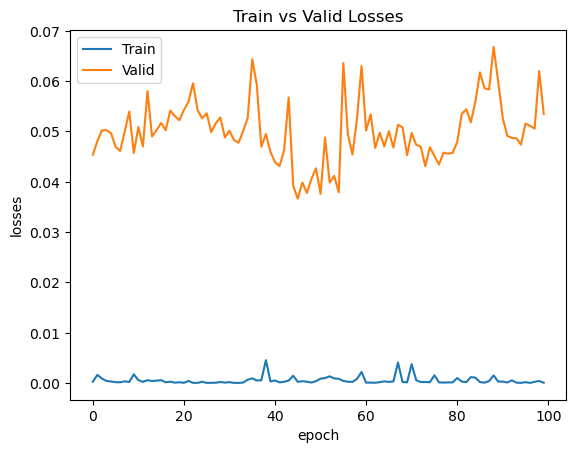

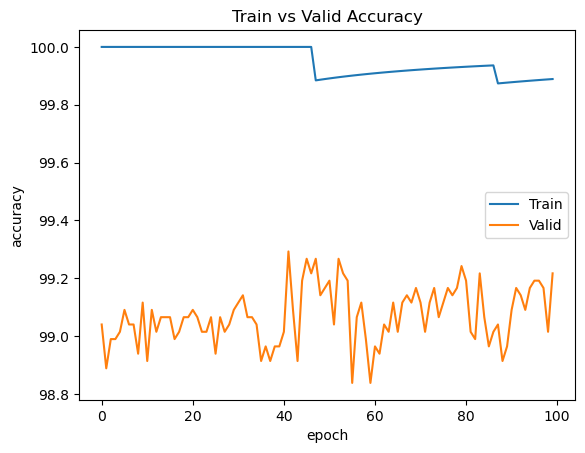

In [ ]:
from IPython.display import display, HTML, Audio, Image
from IPython.core.display import HTML

import collections
import gc
epoch_print_gap = 1

#      0.95 |         1e-05  | 0.001  |           32 |    0.0451909   |    99.0147 |                  100

#batch size is already set as 32 train_nucleus_dataloader.batch_size =32

# clear cache every run to handle kaggle disconnect issue
gc.collect()
torch.cuda.empty_cache()

# learning rate
lr=0.001

# l2 regularization
weight_decay = 1e-05

# momentum
momentum = 0.95

# number of epochs
n_epochs = 100

# train model
model_task2 = train_validate_graph(
    n_epochs = n_epochs,
    model = model,
    device = device,
    lr = lr,
    momentum = momentum,
    weight_decay = weight_decay,
    train_loader = train_nucleus_dataloader,
    val_loader=val_nucleus_dataloader,
    weights_init=None,
)

# alarm when model training is finished
wave = np.sin(2*np.pi*560*np.arange(200_000*2)/50_000)
Audio(wave,rate=30_000,autoplay=True)

Evaluate our model again on validation data and display the score

In [ ]:
validation_loop(model_task2,device,val_nucleus_dataloader)


 Average loss: -13.4130, Accuracy: 3927/3958 (99%)



Again, lets save the model, so we can load it easily later when we need it :)

In [ ]:
# Save model
torch.save(model_task2, "model_task2.pt")
#load_model_task1 = torch.load("model_task2.pt")

# Confusion Matrix

Lets plot confusion matrix and class accuracies to see how our model performs on the validation set

Class of each type:  Accuracy:  tensor([99.9081, 99.4129, 99.5197, 97.6456])


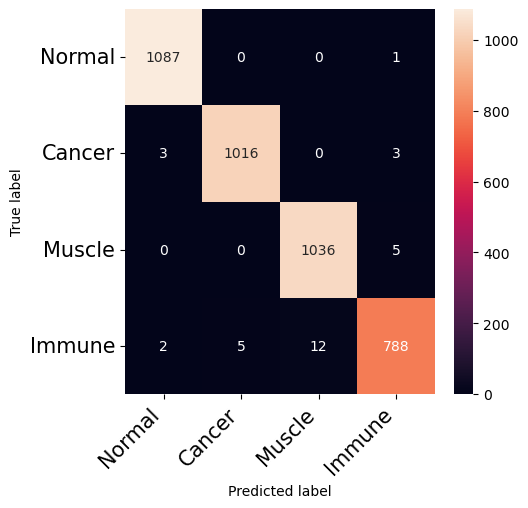

In [ ]:
import seaborn as sns

# number of classes 'Normal','Cancer','Muscle','Immune'
numberofclasses = 4

# run predict on the model
confusion_matrix = torch.zeros(numberofclasses, numberofclasses)
with torch.no_grad():
    for i, inputs in enumerate(val_nucleus_dataloader):
        classes = inputs['label'].to(device)
        inputs = inputs['image'].to(device)
        outputs = model_task2(inputs)
        _, preds = torch.max(outputs, 1)
        for t, p in zip(classes.view(-1), preds.view(-1)):
                confusion_matrix[t.long(), p.long()] += 1

plt.figure(figsize=(5,5))

# define classes a string to show on confusion matrix
class_names = list(['Normal','Cancer','Muscle','Immune'])

df_cm = pd.DataFrame(confusion_matrix, index=class_names, columns=class_names).astype(int)
heatmap = sns.heatmap(df_cm, annot=True, fmt="d")
heatmap.yaxis.set_ticklabels(heatmap.yaxis.get_ticklabels(), rotation=0, ha='right',fontsize=15)
heatmap.xaxis.set_ticklabels(heatmap.xaxis.get_ticklabels(), rotation=45, ha='right',fontsize=15)
plt.ylabel('True label')
plt.xlabel('Predicted label')

# Show each class accuracy
class_accuracy=100*confusion_matrix.diagonal()/confusion_matrix.sum(1)# sum each row
print("Class of each type:  Accuracy: ", class_accuracy)

The confusion matrix above shows that the Resnet retrained model achieved a high level of accuracy in predicting cancer cells, with a success rate of around 99.4%. This result is significantly better than what was achieved with model 1. Also, the Resnet retrained model was trained on millions of images, which has likely helped to improve the accuracy of its image classification.

Also, to further enhance this confusion matrix, we might overfit the model and add more regularization which is indeed what i did on mutiple epoch. That resulted in a better accuracy of ```99.6%```



# Captum interpretation (Occlusion-based attribution)

let us try a different approach to attribution. We can estimate which areas of the image are critical for the classifier's decision by occluding them and quantifying how the decision changes.

We run a sliding window of size 15x15 (defined via `sliding_window_shapes`) with a stride of 8 along both image dimensions (a defined via `strides`). At each location, we occlude the image with a baseline value of 0 which correspondes to a gray patch (defined via `baselines`).

In [ ]:
# helper method to show batch images
def show_Occlusion_images(images,labels,batch_size):
    fig = plt.figure(figsize = (25,5))
    for i in range(batch_size):
        ax = fig.add_subplot(2 , int(batch_size/2) , i+1, xticks = [] , yticks = [])
        #ax.imshow(images[i].transpose(2,1,0).squeeze())
        ax.imshow(np.transpose(images[i].squeeze().cpu().detach().numpy(), (2,1,0)))
        temp_label=labels[i]
        if temp_label == 0:
            ax.set_title('Normal#{}'.format(temp_label))
        if temp_label == 1:
            ax.set_title('Cancer#{}'.format(temp_label))
        if temp_label == 2:
            ax.set_title('Muscle#{}'.format(temp_label))
        if temp_label == 3:
            ax.set_title('Immune#{}'.format(temp_label))
    plt.tight_layout()

lets see how occlusion shows important pixels to determine the class on our images by sliding `15x15` sliding windows with stride of `8x8`

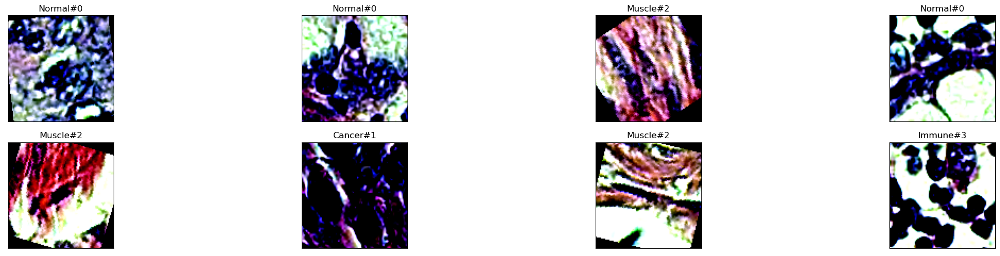

In [ ]:
iterator = next(iter(val_nucleus_dataloader))
images , labels =  np.asarray(iterator['image']) ,  np.asarray(iterator['label'])
show_batch_images(images,labels,8)

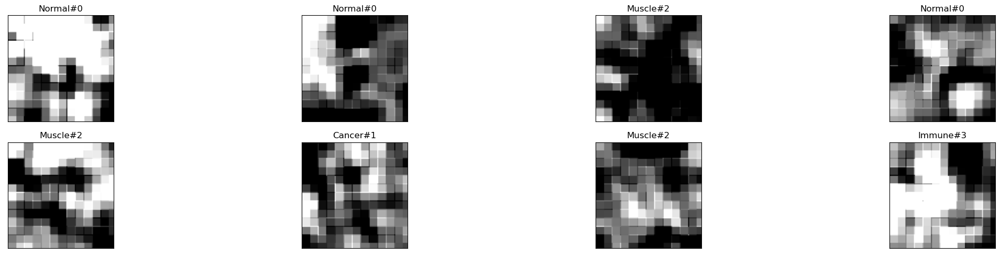

In [ ]:
iterator = next(iter(val_nucleus_dataloader))
images , labels =  iterator['image'][0:8].to(device) ,  iterator['label'][0:8].to(device)

attributions_occ = occlusion.attribute(images,
                                       strides = (3, 8, 8),
                                       target=preds,
                                       sliding_window_shapes=(3,15, 15),
                                       baselines=0)
show_Occlusion_images(attributions_occ,labels,8)

Let us visualize the attribution, focusing on the areas with positive attribution (those that are critical for the classifier's decision):

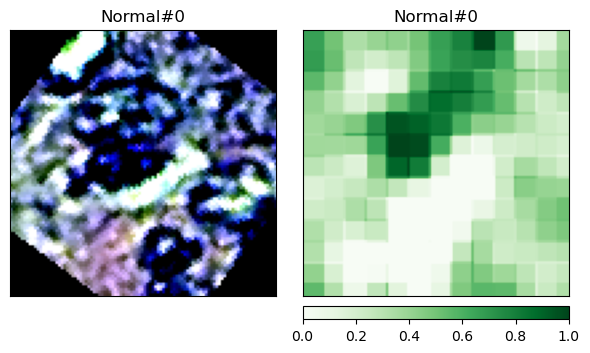

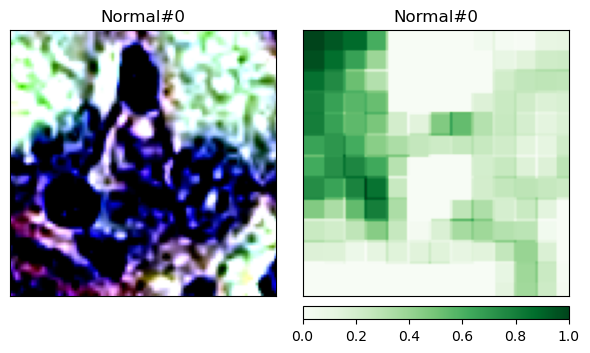

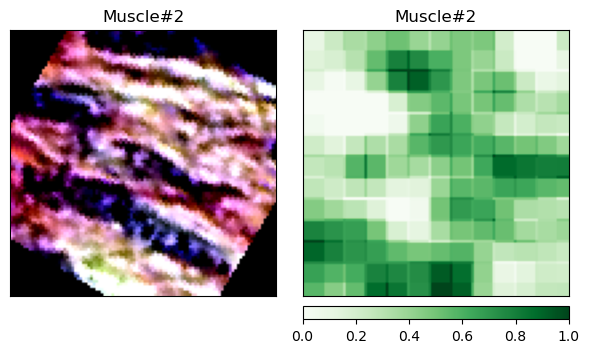

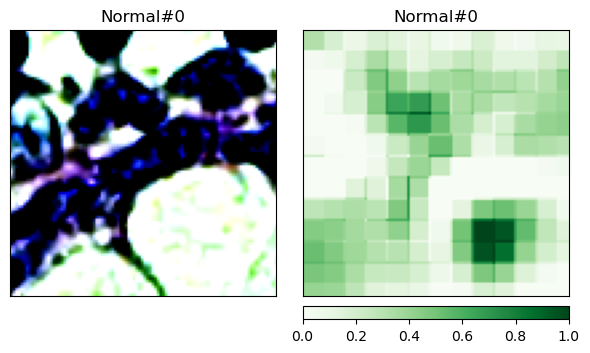

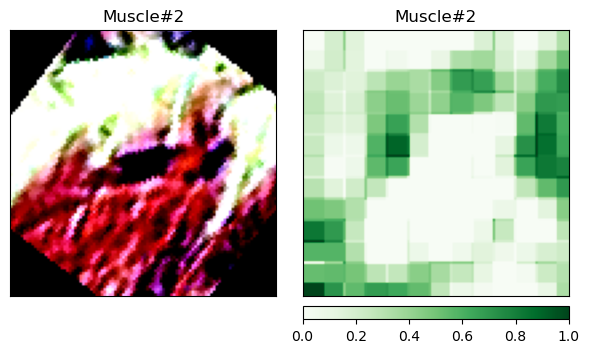

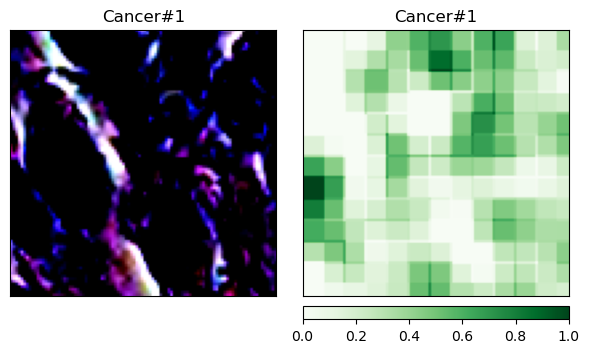

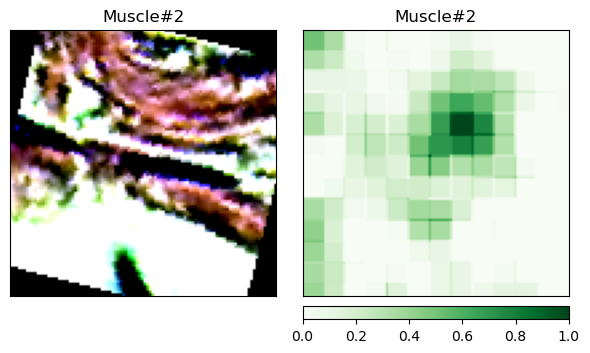

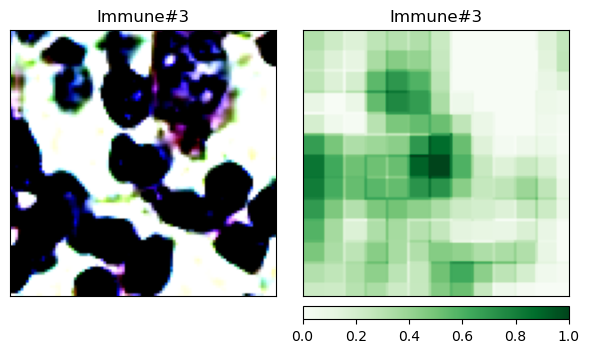

In [ ]:
from captum.attr import Occlusion
from captum.attr import visualization as viz

# bring back our model to GPU
#model=model.to(device)

occlusion = Occlusion(model_task2)

#loop around each batch and compute the integrated gradient for the first batch only then break
with torch.no_grad():
    for i, inputs in enumerate(val_nucleus_dataloader):
        classes = inputs['label'][0:8].to(device)
        inputs = inputs['image'][0:8].to(device)
        outputs = model_task2(inputs)
        _, preds = torch.max(outputs, 1)
        #attributions_ig_nt = noise_tunnel.attribute(inputs, nt_samples=1, nt_type='smoothgrad_sq', target=preds)
        attributions_occ = occlusion.attribute(inputs,
                                       strides = (3, 8, 8),
                                       target=preds,
                                       sliding_window_shapes=(3,15, 15),
                                       baselines=0)

        #show images
        for i in range(len(attributions_occ)):
            temp_label=preds[i]
            if temp_label == 0:
                temp_label=['Normal#{}'.format(temp_label),'Normal#{}'.format(temp_label)]
            if temp_label == 1:
                temp_label=['Cancer#{}'.format(temp_label),'Cancer#{}'.format(temp_label)]
            if temp_label == 2:
                temp_label=['Muscle#{}'.format(temp_label),'Muscle#{}'.format(temp_label)]
            if temp_label == 3:
                temp_label=['Immune#{}'.format(temp_label),'Immune#{}'.format(temp_label)]
            _ = viz.visualize_image_attr_multiple(np.transpose(attributions_occ[i].squeeze().cpu().detach().numpy(), (2,1,0)),
                                      np.transpose(inputs[i].squeeze().cpu().detach().numpy(), (2,1,0)),
                                      ["original_image", "heat_map"],
                                      ["all", "positive"],
                                      show_colorbar=True,
                                      outlier_perc=2,titles=temp_label,fig_size=(6,6)
                                        )


            #show only 8, if more showed, kaggle wont be able to save the notebook
            if i==8:
                break
        break


#### Finally, we train our model on test images and obtain the submission.csv, then submit it to kaggle :)

In [ ]:
test_accuracy_and_submit(model_task2)

,Filename,Label
0,10001.png,3
1,10002.png,3
2,10003.png,2
3,10004.png,3
4,10005.png,3
...,...,...
5036,15037.png,1
5037,15038.png,1
5038,15039.png,0
5039,15040.png,2


Below are the result obtained after submitting model 2. `Note:` I have worked on colab pro and kaggle to tweak the model and get the best accuracy possible, and thats because both give limited time and GPU resources. Many trail and error was performed and for the sake of making this notebook clean and clear most of that trail and error work was removed.

![image.png](attachment:db4d2caf-ba42-498f-b1ed-0f82559cbdbb.png)

# Side Work: Multiple normal runs of Task1 CNN models to find the best intial fit model

Epoch: 1, Training Loss: 0.554, Validation Loss: 0.257, train accuracy = 77.236, val accuracy = 90.121

Epoch: 2, Training Loss: 0.263, Validation Loss: 0.233, train accuracy = 83.485, val accuracy = 90.753

Epoch: 3, Training Loss: 0.218, Validation Loss: 0.270, train accuracy = 86.196, val accuracy = 89.565

Epoch: 4, Training Loss: 0.209, Validation Loss: 0.233, train accuracy = 87.603, val accuracy = 90.601

Epoch: 5, Training Loss: 0.184, Validation Loss: 0.189, train accuracy = 88.666, val accuracy = 92.496

Epoch: 6, Training Loss: 0.164, Validation Loss: 0.199, train accuracy = 89.522, val accuracy = 91.637

Epoch: 7, Training Loss: 0.150, Validation Loss: 0.188, train accuracy = 90.235, val accuracy = 93.128

Epoch: 8, Training Loss: 0.137, Validation Loss: 0.176, train accuracy = 90.808, val accuracy = 93.204

Epoch: 9, Training Loss: 0.119, Validation Loss: 0.230, train accuracy = 91.320, val accuracy = 91.713

Epoch: 10, Training Loss: 0.109, Validation Loss: 0.181, train a

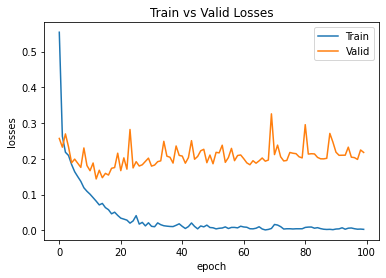

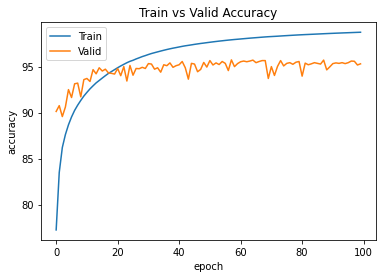

In [ ]:
from IPython.display import display, HTML, Audio, Image
from IPython.core.display import HTML

import collections
import gc
epoch_print_gap = 1

#| train_validate_graph_raytune_54dfb_00002 | TERMINATED | 172.28.0.12:73784  |       0.95 |         1e-05  | 0.001  |           32 | 0.205234 |    96.1344 |                  100 |

#batch size is already set as 32 train_nucleus_dataloader.batch_size =32

# clear cache every run to handle kaggle disconnect issue
gc.collect()
torch.cuda.empty_cache()

# learning rate
lr=0.001

# l2 regularization
weight_decay = 1e-05

# momentum
momentum = 0.95

# number of epochs
n_epochs = 100

# train model
model = train_validate_graph(
    n_epochs = n_epochs,
    model = model_cnn_1(),
    device = device,
    lr = lr,
    momentum = momentum,
    weight_decay = weight_decay,
    train_loader = train_nucleus_dataloader,
    val_loader=val_nucleus_dataloader,
    weights_init=None,
)

# alarm when model training is finished
wave = np.sin(2*np.pi*560*np.arange(20_000*2)/50_000)
Audio(wave,rate=30_000,autoplay=True)

Epoch: 1, Training Loss: 0.994, Validation Loss: 0.595, train accuracy = 53.974, val accuracy = 78.019

Epoch: 2, Training Loss: 0.464, Validation Loss: 0.403, train accuracy = 68.010, val accuracy = 85.649

Epoch: 3, Training Loss: 0.340, Validation Loss: 0.323, train accuracy = 74.449, val accuracy = 87.468

Epoch: 4, Training Loss: 0.287, Validation Loss: 0.267, train accuracy = 78.157, val accuracy = 89.363

Epoch: 5, Training Loss: 0.258, Validation Loss: 0.246, train accuracy = 80.544, val accuracy = 90.172

Epoch: 6, Training Loss: 0.232, Validation Loss: 0.247, train accuracy = 82.305, val accuracy = 90.374

Epoch: 7, Training Loss: 0.227, Validation Loss: 0.224, train accuracy = 83.559, val accuracy = 91.182

Epoch: 8, Training Loss: 0.220, Validation Loss: 0.260, train accuracy = 84.562, val accuracy = 89.666

Epoch: 9, Training Loss: 0.226, Validation Loss: 0.236, train accuracy = 85.306, val accuracy = 90.879

Epoch: 10, Training Loss: 0.202, Validation Loss: 0.239, train a

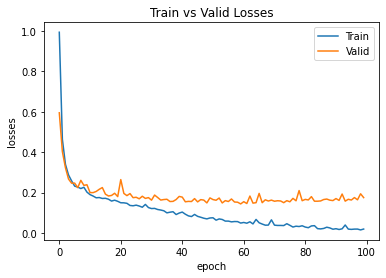

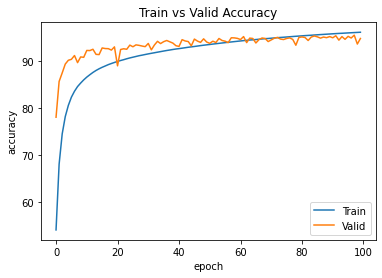

In [ ]:
from IPython.display import display, HTML, Audio, Image
from IPython.core.display import HTML

import collections
import gc
epoch_print_gap = 1

# clear cache every run to handle kaggle disconnect issue
gc.collect()
torch.cuda.empty_cache()

# learning rate
lr=0.0001

# l2 regularization
weight_decay = 0 #0.05

# momentum
momentum = 0.97

# number of epochs
n_epochs = 100

# train model
model = train_validate_graph(
    n_epochs = n_epochs,
    model = model_cnn_1(),
    device = device,
    lr = lr,
    momentum = momentum,
    weight_decay = weight_decay,
    train_loader = train_nucleus_dataloader,
    val_loader=val_nucleus_dataloader,
    weights_init=None,
)

# alarm when model training is finished
wave = np.sin(2*np.pi*560*np.arange(20_000*2)/50_000)
Audio(wave,rate=30_000,autoplay=True)

# Train on CNN_1 Model with weight decay and without

Epoch: 1, Training Loss: 1.077, Validation Loss: 0.851, train accuracy = 55.166, val accuracy = 69.025
Epoch: 2, Training Loss: 0.716, Validation Loss: 0.613, train accuracy = 64.593, val accuracy = 77.918
Epoch: 3, Training Loss: 0.528, Validation Loss: 0.485, train accuracy = 70.143, val accuracy = 82.239
Epoch: 4, Training Loss: 0.432, Validation Loss: 0.454, train accuracy = 73.736, val accuracy = 81.430
Epoch: 5, Training Loss: 0.374, Validation Loss: 0.357, train accuracy = 76.268, val accuracy = 87.519
Epoch: 6, Training Loss: 0.339, Validation Loss: 0.366, train accuracy = 78.123, val accuracy = 86.230
Epoch: 7, Training Loss: 0.319, Validation Loss: 0.318, train accuracy = 79.476, val accuracy = 88.353
Epoch: 8, Training Loss: 0.297, Validation Loss: 0.316, train accuracy = 80.622, val accuracy = 87.519
Epoch: 9, Training Loss: 0.290, Validation Loss: 0.287, train accuracy = 81.526, val accuracy = 88.934
Epoch: 10, Training Loss: 0.275, Validation Loss: 0.337, train accuracy =

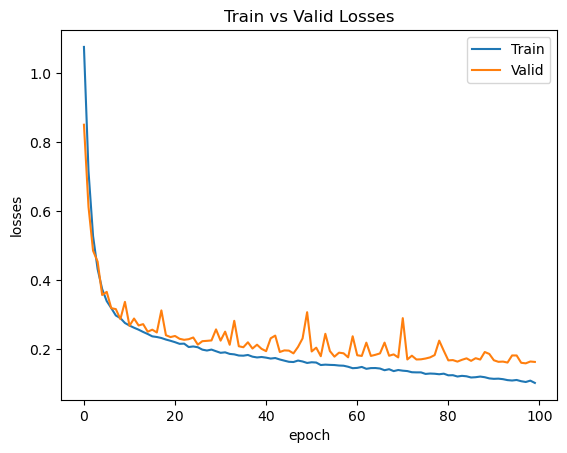

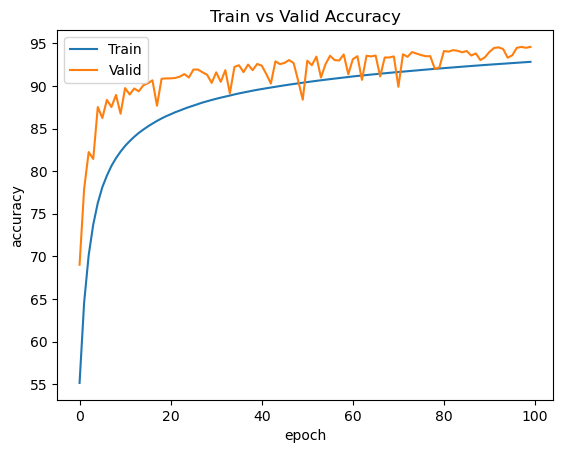

In [ ]:
from IPython.display import display, HTML, Audio, Image
from IPython.core.display import HTML

import collections
import gc
epoch_print_gap = 1

# clear cache every run to handle kaggle disconnect issue
gc.collect()
torch.cuda.empty_cache()

# learning rate
lr=0.001

# l2 regularization
weight_decay = 0#0.05

# momentum
momentum = 0

# number of epochs
n_epochs = 100

# train model
model = train_validate_graph(
    n_epochs = n_epochs,
    model = model_cnn_1(),
    device = device,
    lr = lr,
    momentum = momentum,
    weight_decay = weight_decay,
    train_loader = train_nucleus_dataloader,
    val_loader=val_nucleus_dataloader,
    weights_init=None,
)

# alarm when model training is finished
wave = np.sin(2*np.pi*560*np.arange(20_000*2)/50_000)
Audio(wave,rate=30_000,autoplay=True)

Epoch: 1, Training Loss: 1.113, Validation Loss: 0.895, train accuracy = 50.108, val accuracy = 65.538
Epoch: 2, Training Loss: 0.758, Validation Loss: 0.628, train accuracy = 61.230, val accuracy = 78.348
Epoch: 3, Training Loss: 0.542, Validation Loss: 0.496, train accuracy = 67.724, val accuracy = 82.011
Epoch: 4, Training Loss: 0.462, Validation Loss: 0.443, train accuracy = 71.605, val accuracy = 83.881
Epoch: 5, Training Loss: 0.412, Validation Loss: 0.419, train accuracy = 74.297, val accuracy = 83.931
Epoch: 6, Training Loss: 0.377, Validation Loss: 0.377, train accuracy = 76.278, val accuracy = 86.458
Epoch: 7, Training Loss: 0.345, Validation Loss: 0.458, train accuracy = 77.885, val accuracy = 81.531
Epoch: 8, Training Loss: 0.327, Validation Loss: 0.324, train accuracy = 79.164, val accuracy = 87.923
Epoch: 9, Training Loss: 0.314, Validation Loss: 0.348, train accuracy = 80.189, val accuracy = 87.216
Epoch: 10, Training Loss: 0.303, Validation Loss: 0.301, train accuracy =

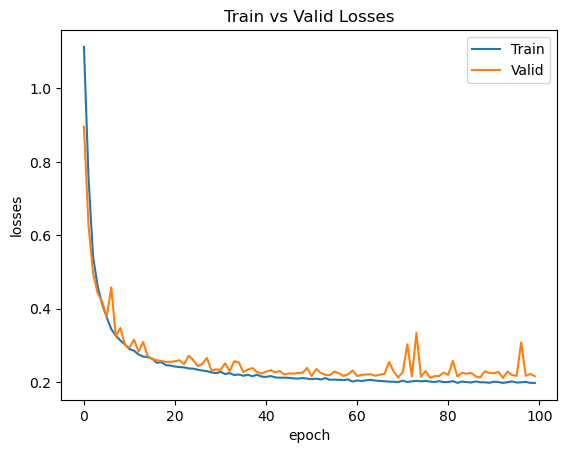

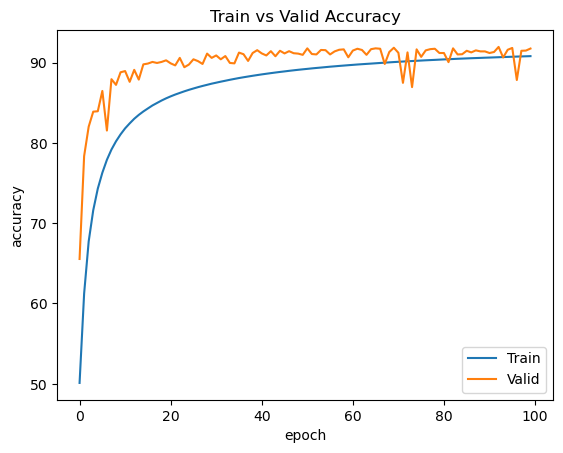

In [ ]:
from IPython.display import display, HTML, Audio, Image
from IPython.core.display import HTML

import collections
import gc
epoch_print_gap = 1

# clear cache every run to handle kaggle disconnect issue
gc.collect()
torch.cuda.empty_cache()

# learning rate
lr=0.001

# l2 regularization
weight_decay = 0.05

# momentum
momentum = 0

# number of epochs
n_epochs = 100

# train model
model = train_validate_graph(
    n_epochs = n_epochs,
    model = model_cnn_1(),
    device = device,
    lr = lr,
    momentum = momentum,
    weight_decay = weight_decay,
    train_loader = train_nucleus_dataloader,
    val_loader=val_nucleus_dataloader,
    weights_init=None,
)

# alarm when model training is finished
wave = np.sin(2*np.pi*560*np.arange(20_000*2)/50_000)
Audio(wave,rate=30_000,autoplay=True)

# Train on CNN_2 Model with weight decay and without

Epoch: 1, Training Loss: 1.302, Validation Loss: 1.077, train accuracy = 33.994, val accuracy = 59.020
Epoch: 2, Training Loss: 0.911, Validation Loss: 0.844, train accuracy = 48.256, val accuracy = 62.607
Epoch: 3, Training Loss: 0.738, Validation Loss: 0.665, train accuracy = 56.079, val accuracy = 74.987
Epoch: 4, Training Loss: 0.601, Validation Loss: 0.552, train accuracy = 61.184, val accuracy = 78.423
Epoch: 5, Training Loss: 0.501, Validation Loss: 0.472, train accuracy = 65.140, val accuracy = 82.188
Epoch: 6, Training Loss: 0.431, Validation Loss: 0.424, train accuracy = 68.324, val accuracy = 84.058
Epoch: 7, Training Loss: 0.384, Validation Loss: 0.383, train accuracy = 70.813, val accuracy = 85.498
Epoch: 8, Training Loss: 0.350, Validation Loss: 0.365, train accuracy = 72.825, val accuracy = 85.902
Epoch: 9, Training Loss: 0.318, Validation Loss: 0.326, train accuracy = 74.504, val accuracy = 87.342
Epoch: 10, Training Loss: 0.290, Validation Loss: 0.333, train accuracy =

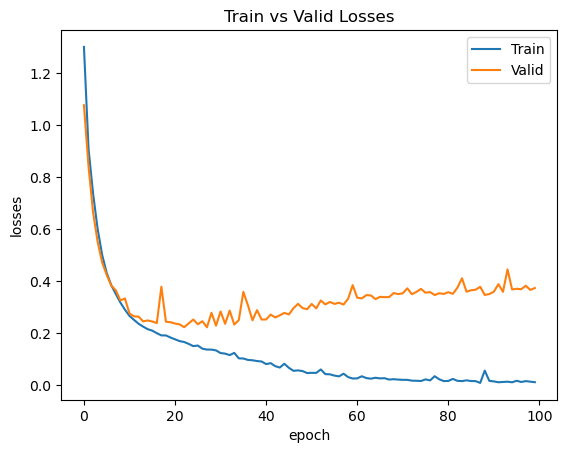

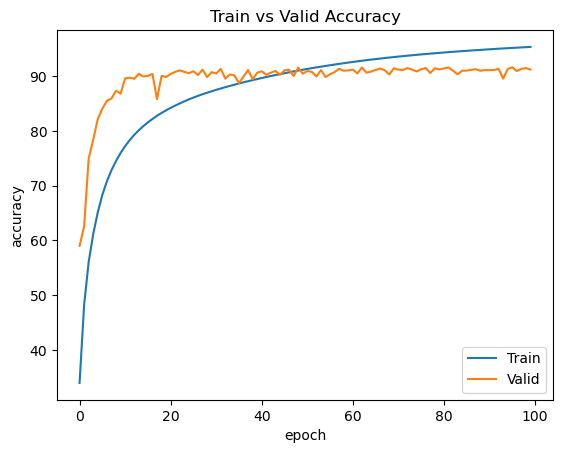

In [ ]:
from IPython.display import display, HTML, Audio, Image
from IPython.core.display import HTML

import collections
import gc
epoch_print_gap = 1

# clear cache every run to handle kaggle disconnect issue
gc.collect()
torch.cuda.empty_cache()

# learning rate
lr=0.001

# l2 regularization
weight_decay = 0#0.05

# momentum
momentum = 0

# number of epochs
n_epochs = 100

# train model
model = train_validate_graph(
    n_epochs = n_epochs,
    model = model_cnn_2(),
    device = device,
    lr = lr,
    momentum = momentum,
    weight_decay = weight_decay,
    train_loader = train_nucleus_dataloader,
    val_loader=val_nucleus_dataloader,
    weights_init=None,
)

# alarm when model training is finished
wave = np.sin(2*np.pi*560*np.arange(20_000*2)/50_000)
Audio(wave,rate=30_000,autoplay=True)

Epoch: 1, Training Loss: 1.214, Validation Loss: 0.979, train accuracy = 44.834, val accuracy = 57.125
Epoch: 2, Training Loss: 0.866, Validation Loss: 0.793, train accuracy = 55.095, val accuracy = 70.566
Epoch: 3, Training Loss: 0.720, Validation Loss: 0.689, train accuracy = 60.747, val accuracy = 73.421
Epoch: 4, Training Loss: 0.615, Validation Loss: 0.584, train accuracy = 64.428, val accuracy = 77.388
Epoch: 5, Training Loss: 0.545, Validation Loss: 0.549, train accuracy = 67.199, val accuracy = 78.979
Epoch: 6, Training Loss: 0.503, Validation Loss: 0.533, train accuracy = 69.408, val accuracy = 79.409
Epoch: 7, Training Loss: 0.467, Validation Loss: 0.502, train accuracy = 71.265, val accuracy = 80.950
Epoch: 8, Training Loss: 0.435, Validation Loss: 0.446, train accuracy = 72.903, val accuracy = 83.679
Epoch: 9, Training Loss: 0.400, Validation Loss: 0.420, train accuracy = 74.329, val accuracy = 84.689
Epoch: 10, Training Loss: 0.373, Validation Loss: 0.390, train accuracy =

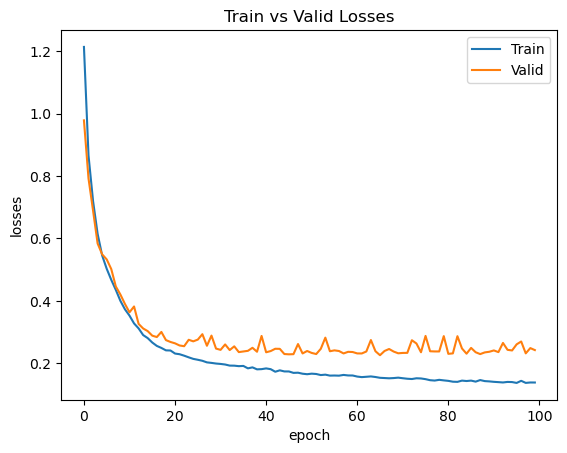

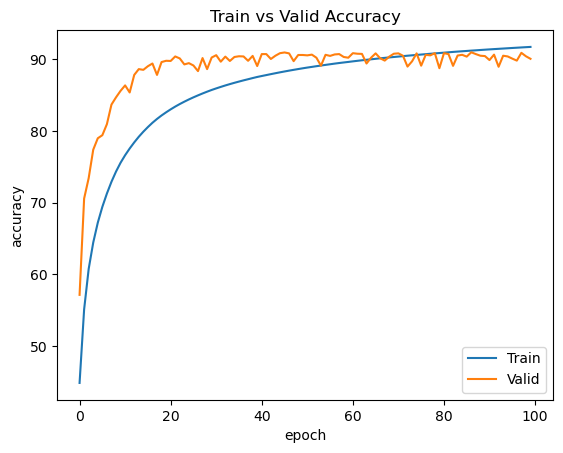

In [ ]:
from IPython.display import display, HTML, Audio, Image
from IPython.core.display import HTML

import collections
import gc
epoch_print_gap = 1

# clear cache every run to handle kaggle disconnect issue
gc.collect()
torch.cuda.empty_cache()

# learning rate
lr=0.001

# l2 regularization
weight_decay = 0.05

# momentum
momentum = 0

# number of epochs
n_epochs = 100

# train model
model = train_validate_graph(
    n_epochs = n_epochs,
    model = model_cnn_2(),
    device = device,
    lr = lr,
    momentum = momentum,
    weight_decay = weight_decay,
    train_loader = train_nucleus_dataloader,
    val_loader=val_nucleus_dataloader,
    weights_init=None,
)

# alarm when model training is finished
wave = np.sin(2*np.pi*560*np.arange(20_000*2)/50_000)
Audio(wave,rate=30_000,autoplay=True)

# Train on CNN_3 Model with weight decay and without

Epoch: 1, Training Loss: 1.130, Validation Loss: 0.913, train accuracy = 49.448, val accuracy = 62.708
Epoch: 2, Training Loss: 0.802, Validation Loss: 0.724, train accuracy = 58.295, val accuracy = 72.638
Epoch: 3, Training Loss: 0.625, Validation Loss: 0.556, train accuracy = 64.472, val accuracy = 79.661
Epoch: 4, Training Loss: 0.506, Validation Loss: 0.476, train accuracy = 68.635, val accuracy = 82.137
Epoch: 5, Training Loss: 0.445, Validation Loss: 0.448, train accuracy = 71.629, val accuracy = 82.466
Epoch: 6, Training Loss: 0.399, Validation Loss: 0.393, train accuracy = 73.960, val accuracy = 85.472
Epoch: 7, Training Loss: 0.362, Validation Loss: 0.387, train accuracy = 75.828, val accuracy = 84.866
Epoch: 8, Training Loss: 0.335, Validation Loss: 0.333, train accuracy = 77.300, val accuracy = 87.721
Epoch: 9, Training Loss: 0.315, Validation Loss: 0.373, train accuracy = 78.500, val accuracy = 84.942
Epoch: 10, Training Loss: 0.303, Validation Loss: 0.299, train accuracy =

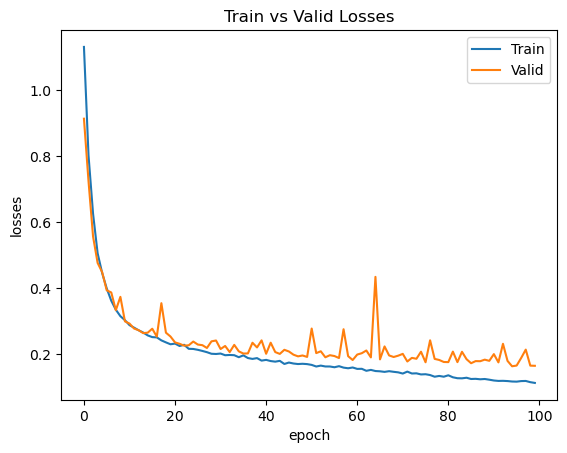

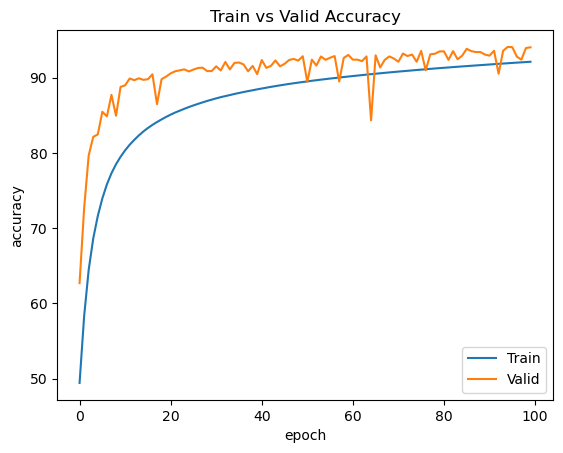

In [ ]:
from IPython.display import display, HTML, Audio, Image
from IPython.core.display import HTML

import collections
import gc
epoch_print_gap = 1

# clear cache every run to handle kaggle disconnect issue
gc.collect()
torch.cuda.empty_cache()

# learning rate
lr=0.001

# l2 regularization
weight_decay = 0#0.05

# momentum
momentum = 0

# number of epochs
n_epochs = 100

# train model
model = train_validate_graph(
    n_epochs = n_epochs,
    model = model_cnn_3(),
    device = device,
    lr = lr,
    momentum = momentum,
    weight_decay = weight_decay,
    train_loader = train_nucleus_dataloader,
    val_loader=val_nucleus_dataloader,
    weights_init=None,
)

# alarm when model training is finished
wave = np.sin(2*np.pi*560*np.arange(20_000*2)/50_000)
Audio(wave,rate=30_000,autoplay=True)

with weight decay

Epoch: 1, Training Loss: 1.369, Validation Loss: 0.912, train accuracy = 50.227, val accuracy = 60.915
Epoch: 2, Training Loss: 0.754, Validation Loss: 0.678, train accuracy = 59.557, val accuracy = 73.926
Epoch: 3, Training Loss: 0.591, Validation Loss: 0.553, train accuracy = 65.710, val accuracy = 78.853
Epoch: 4, Training Loss: 0.501, Validation Loss: 0.492, train accuracy = 69.499, val accuracy = 81.885
Epoch: 5, Training Loss: 0.453, Validation Loss: 0.466, train accuracy = 72.318, val accuracy = 82.441
Epoch: 6, Training Loss: 0.415, Validation Loss: 0.500, train accuracy = 74.399, val accuracy = 79.586
Epoch: 7, Training Loss: 0.380, Validation Loss: 0.369, train accuracy = 76.121, val accuracy = 86.837
Epoch: 8, Training Loss: 0.352, Validation Loss: 0.342, train accuracy = 77.521, val accuracy = 87.620
Epoch: 9, Training Loss: 0.335, Validation Loss: 0.357, train accuracy = 78.653, val accuracy = 86.584
Epoch: 10, Training Loss: 0.320, Validation Loss: 0.323, train accuracy =

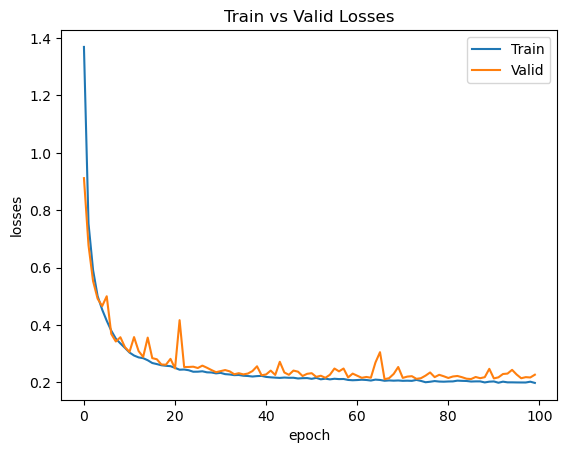

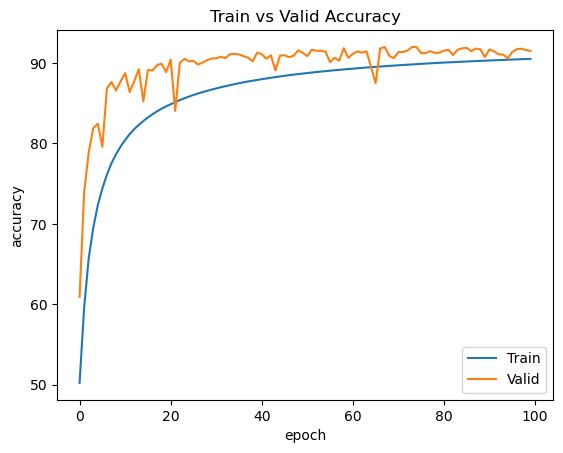

In [ ]:
from IPython.display import display, HTML, Audio, Image
from IPython.core.display import HTML

import collections
import gc
epoch_print_gap = 1

# clear cache every run to handle kaggle disconnect issue
gc.collect()
torch.cuda.empty_cache()

# learning rate
lr=0.001

# l2 regularization
weight_decay = 0.05

# momentum
momentum = 0

# number of epochs
n_epochs = 100

# train model
model = train_validate_graph(
    n_epochs = n_epochs,
    model = model_cnn_3(),
    device = device,
    lr = lr,
    momentum = momentum,
    weight_decay = weight_decay,
    train_loader = train_nucleus_dataloader,
    val_loader=val_nucleus_dataloader,
    weights_init=None,
)

# alarm when model training is finished
wave = np.sin(2*np.pi*560*np.arange(20_000*2)/50_000)
Audio(wave,rate=30_000,autoplay=True)

In [ ]:
import collections
import gc
epoch_print_gap = 1

# clear cache every run to handle kaggle disconnect issue
gc.collect()
torch.cuda.empty_cache()

# learning rate
lr=0.001

# l2 regularization
weight_decay = 0#0.05

# momentum
momentum = 0

# number of epochs
n_epochs = 1

# train model
model = training_loop(
    n_epochs = n_epochs,
    model = model_cnn_6(),
    device = device,
    lr = lr,
    momentum = momentum,
    weight_decay = weight_decay,
    train_loader = train_nucleus_dataloader,
)

# alarm when model training is finished
wave = np.sin(2*np.pi*560*np.arange(20_000*2)/50_000)
Audio(wave,rate=30_000,autoplay=True)

In [ ]:
validation_loop(model,device,val_nucleus_dataloader)


 Average loss: -9.4074, Accuracy: 3744/3958 (95%)



Using voting machansimm to apply transformation mutiple times and then decide model label based on label appeared at each transformation

In [ ]:
test_img_ids = list(range(10001,15042))
test_img_pred = dict()
test_img_dir = '/kaggle/input/deep-learning-for-msc-2022-23/test/%s.png'


with torch.no_grad():
    for test_img_id in test_img_ids:
        img = read_image(test_img_dir % test_img_id, mode=ImageReadMode.RGB)
        inputs = img[None,:].to(device=device,dtype=dtype)
        outputs = model(inputs)
        vote = torch.zeros_like(outputs)
        vote[0, outputs.argmax(keepdim=True)] += 1

        outputs = model(transform(img)[None,:].to(device=device))
        vote[0, outputs.argmax(keepdim=True)] += 1

        outputs = model(transform(img)[None,:].to(device=device))
        vote[0, outputs.argmax(keepdim=True)] += 1

        outputs = model(transform(img)[None,:].to(device=device))
        vote[0, outputs.argmax(keepdim=True)] += 1

        outputs = model(transform(img)[None,:].to(device=device))
        vote[0, outputs.argmax(keepdim=True)] += 1

        predicted = vote.argmax(dim=1, keepdim=True)
        test_img_pred[str(test_img_id)+'.png'] = predicted.item()

In [ ]:
#example
test_img_pred['15041.png']

0

In [ ]:
submission = pd.DataFrame(list(test_img_pred.items()), columns= ['Filename', 'Label'])
submission.to_csv('/kaggle/working/submission.csv',index=False)
submission

,Filename,Label
0,10001.png,3
1,10002.png,3
2,10003.png,2
3,10004.png,3
4,10005.png,3
...,...,...
5036,15037.png,1
5037,15038.png,1
5038,15039.png,0
5039,15040.png,2
